In [1]:
base = 128
batch_size = 128

# IMPORTS 

# Torch for data loading and for model buiding
import torch
import torch.nn as nn
from torch import optim
from torch.optim.lr_scheduler import ReduceLROnPlateau
import torchvision
from torchvision import transforms
import torchvision.models as models
from torch.utils.data import Dataset, DataLoader, random_split
from torchsummary import summary
import torch.nn.functional as F
from torchvision.utils import make_grid, save_image
from pytorch_msssim import ssim #, ms_ssim, SSIM, MS_SSIM

# Data preprocessing
import pandas as pd
from pandas.io.json import json_normalize
import json
import os
import re

# Visualisation
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats 
from PIL import Image
from pylab import rcParams
import imageio


# Maths
import math
import numpy as np
from sklearn import metrics

# Other
from time import perf_counter
from collections import Counter,OrderedDict
import random
import warnings
import time

# Clustering
from sklearn.cluster import AgglomerativeClustering
import scipy.cluster.hierarchy as sch
from sklearn.manifold import TSNE

# Check if GPU available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)

Using device: cpu


In [2]:
HU_UpperBound = 600
HU_LowerBound = -1000
base = 32
latent_size = 8
annealing = 1     
ssim_indicator = 1
batch_size = 64
alpha_scalar = 0.15
beta = 0.5
lr = 2e-4
ssim_scalar = 1

In [3]:
IMAGE_DIR = r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images"


all_files_list = [f for f in os.listdir(IMAGE_DIR)]
all_files_list.sort()
        
print(len(all_files_list))
print(all_files_list[0:10])

def parameter_count(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

# Create class to load image data from files
class LoadImages(Dataset):
    def __init__(self, main_dir, files_list):
        # Set the loading directory
        self.main_dir = main_dir

        # Transforms
        self.transform = transforms.Compose([transforms.ToTensor()])

        # Get list of all image file names
        self.all_imgs = files_list
        
    def __len__(self):
        # Return the previously computed number of images
        return len(self.all_imgs)    

    def __getitem__(self, index):
        # Get image location
        img_loc = self.main_dir + self.all_imgs[index]
        # Represent image as a tensor
        img = np.load(img_loc)
        # scaling idea from https://www.mdpi.com/2076-3417/10/21/7837
        # set all air (<-1000) to 0 and all bone (>400) to 1, scale all other numbers to between [0,1] 
        img = np.where((-1000 <= img) & (img <= 600), (img - - 1000)/(600 - - 1000), img)
        img[img<-1000] = 0
        img[img>600] = 1
        img = self.transform(img) 
        return img

# Load image data using LoadImages class
images = LoadImages(main_dir=IMAGE_DIR + '/', files_list=all_files_list)
print('number of images:',len(images))
image_loader = DataLoader(images, batch_size, shuffle=False)

# definition of vae model
class Conv(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride=1, padding=0):
        super(Conv, self).__init__()
        
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.GELU()
        )

    def forward(self, x):
        return self.conv(x)

class ConvTranspose(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride=1, padding=0):
        super(ConvTranspose, self).__init__()
        
        self.conv = nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.GELU()
        )

    def forward(self, x):
        return self.conv(x)

#https://distill.pub/2016/deconv-checkerboard/
#  the checkerboard could be reduced by replacing transpose convolutions with bilinear upsampling
class ConvUpsampling(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride=1, padding=0):
        super(ConvUpsampling, self).__init__()
        
        self.scale_factor = kernel_size
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.GELU()
        )
        
    def forward(self, x):
        x = F.interpolate(x, scale_factor=self.scale_factor, mode='bilinear')
        return self.conv(x)

class VAE(nn.Module):
    def __init__(self):
        super(VAE, self).__init__()
        global base, latent_size
        
        # output_width = [ (input_width - kernel_width + 2*padding) / stride ] + 1
        self.encoder = nn.Sequential(
            Conv(1, base, 3, stride=1, padding=1),        # (64 - 3 + 2)/1 + 1  = 64
            Conv(base, 2*base, 3, stride=1, padding=1),   # 64
            Conv(2*base, 2*base, 3, stride=2, padding=1), # (64 - 3 + 2)/2 + 1 = 32
            Conv(2*base, 2*base, 3, stride=1, padding=1), # 32
            Conv(2*base, 4*base, 3, stride=2, padding=1), # (32 - 3 + 2)/2 + 1 = 16
            Conv(4*base, 4*base, 3, stride=1, padding=1), # 16
            Conv(4*base, 4*base, 3, stride=2, padding=1), # (16 - 3 + 2)/2 + 1 = 8
            nn.Conv2d(4*base, 32*base, 8),                # (8 - 8 + 0)/1 + 1 = 1
            nn.GELU()
        )
        self.encoder_mu = nn.Conv2d(32*base, latent_size*base, 1) # (1 - 1)/1 + 1 = 1    ## 32*base = 32*4 = 128  ### 1*512 = 512
        self.encoder_logvar = nn.Conv2d(32*base, latent_size*base, 1)

        # Conv2d_output_width = [ (input_width - kernel_width + 2*padding) / stride ] + 1
        # ConvTranspose_output_width =(input_width −1)*stride − 2*in_padding + dilation*(kernel_width−1) + out_padding +1
        self.decoder = nn.Sequential(
             nn.Conv2d(latent_size*base, 32*base, 1),                       # (1 - 1)/1 + 1 = 1                              ## 32 64
             ConvTranspose(32*base, 4*base, 8),                    # (1-1)*1 + 2*0 + 1(8-1) + 0 + 1  = 8     ## 64 4         
             Conv(4*base, 4*base, 3, padding=1),                   # (8 - 3 + 2)/1 + 1 = 8                          ## 4 4 
             ConvUpsampling(4*base, 4*base, 4, stride=2, padding=1),# (8-1)*2 - 2*1 + 1(4-1) + 0 + 1 = 16     ## 4 4         
             Conv(4*base, 2*base, 3, padding=1),                   # (16 - 3 + 2)/1 + 1 = 16                        ## 4 2 
             ConvUpsampling(2*base, 2*base, 4, stride=2, padding=1),# (16-1)*2 - 2*1 + 1(4-1) + 0 + 1 = 32    ## 2 2         
             Conv(2*base, base, 3, padding=1),                     # 32                                             ## 2 1  
             ConvUpsampling(base, base, 4, stride=2, padding=1),    # (32-1)*2 - 2*1 + 1*(4-1) + 0 + 1 = 64   ## 1 1 
             nn.Conv2d(base, 1, 3, padding=1),                     # 64                                             ## 1 1
            nn.Tanh()
        )
        
    def encode(self, x):
        x = self.encoder(x)
        return self.encoder_mu(x), self.encoder_logvar(x)

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5*logvar) 
        eps = torch.randn_like(std) # mean=0 , std=1
        #z = mu + logvar*self.N.sample(mu.shape)
        return mu + eps*std
    
    def decode(self, z):
        return self.decoder(z)
    
    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparameterize(mu, logvar)
        return self.decode(z), mu, logvar



def plot_results(results_path, filename):   #train_losses, test_losses
    '''
    method for plotting accuracy and loss graphs and saving file in given destination
    '''
    data = torch.load(os.path.join(results_path, "VAE_params.pt"))
    loss = data["train_losses"]
    val_loss = data["test_losses"]
    loss = loss[1:]
    val_loss = val_loss[1:]
    fig, ax1 = plt.subplots()
    plt.plot(loss, 'm', label = 'training loss')
    plt.plot(val_loss, 'g', label = 'test loss')
    plt.yscale("log")
    plt.legend(loc='lower right')
    plt.xlabel('epoch')
    plt.ylabel('loss')
    plt.title('Training and validation loss')
    fig.savefig(os.path.join(results_path, filename))
    plt.show()
    plt.close()
    
def linear_annealing(init, fin, step, annealing_steps):
    """Linear annealing of a parameter."""
    if annealing_steps == 0:
        return fin
    assert fin > init
    delta = fin - init
    annealed = min(init + delta * step / annealing_steps, fin)
    return annealed

# Reconstruction + KL divergence losses summed over all elements and batch
def loss_function(recon_x, x, mu, logvar, epoch):
    global annealing, alpha, beta, batch_size, ssim_indicator, latent_size, ssim_scalar, base
    scale_factor = 1/(batch_size*base)
    # linear annealing: reduce the effect of KL divergence over time
    if annealing == 1:
        C = (linear_annealing(0, 1, epoch, epochs))
    if annealing == 0:
        C = 0
                  
    # 0.5 * sum(1 + log(logvar^2) - mu^2 - logvar^2)
    kld = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp()) * scale_factor
        
    l1_loss = nn.L1Loss(reduction='sum') 
    recon_loss = l1_loss(recon_x, x) * scale_factor
    
    if ssim_scalar == 2:
        ssim_scalar = batch_size
    
    if ssim_indicator == 0:
        recon_mix = recon_loss  
            
    # idea from https://arxiv.org/pdf/1511.08861.pdf     alpha*l1_loss + (1-aplha)*ssim_loss  *guassian kernal (not included!)
    if ssim_indicator == 1:
        # https://github.com/VainF/pytorch-msssim
        ssim_loss = 1 - ssim(x, recon_x, data_range=1, nonnegative_ssim=True)
        recon_mix = alpha*recon_loss + (1-alpha)*ssim_loss*ssim_scalar  
        
    if ssim_indicator == 2:
        # https://github.com/VainF/pytorch-msssim
        ssim_loss = 1 - ms_ssim(x, recon_x, data_range=1, win_size=3)
        recon_mix = alpha*recon_loss + (1-alpha)*ssim_loss*ssim_scalar  

          
    # idea from beta vae: https://openreview.net/pdf?id=Sy2fzU9gl
    beta_norm = (beta*latent_size*base)/(64*64)
    beta_vae_loss = recon_mix + beta_norm*(kld - C).abs()
    pure_loss = recon_loss + kld
        
    ssim_score = ssim(x, recon_x, data_range=1, nonnegative_ssim=True)
    ms_ssim_score = ms_ssim(x, recon_x, data_range=1, win_size=3)
    if epoch%100==1 or (epoch < 3):
        print('recon loss: {:.4f}'.format(recon_loss.item()),'recon mix: {:.4f}'.format(recon_mix.item()), 
              'kld loss: {:.4f}'.format(kld.item()), 'kld loss scaled: {:.4f}'.format((kld - C).abs().item()),
              'SSIM score: {:.4f}'.format(ssim_score.item()), 'MS-SSIM: {:.4f}'.format(ms_ssim_score.item()))

    return beta_vae_loss, recon_loss, kld, ssim_score, pure_loss

print('parameter count:', parameter_count(VAE()))

13852
['0001_NI000_slice000.npy', '0001_NI000_slice001.npy', '0001_NI000_slice002.npy', '0001_NI000_slice003.npy', '0001_NI000_slice004.npy', '0001_NI000_slice005.npy', '0001_NI000_slice006.npy', '0001_NI000_slice007.npy', '0002_NI000_slice000.npy', '0002_NI000_slice001.npy']
number of images: 13852
parameter count: 18613633


In [4]:
model = VAE().to(device)
model.load_state_dict(torch.load(r"C:\Users\mm17b2k\Documents\ARCANE\VAE_lung_lesion_paper\Python\Best_dirichlet_and_gaussian\VAE_params_gaussian1.pt", map_location=torch.device('cpu'))["state_dict"])
model.eval()

VAE(
  (encoder): Sequential(
    (0): Conv(
      (conv): Sequential(
        (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): GELU()
      )
    )
    (1): Conv(
      (conv): Sequential(
        (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): GELU()
      )
    )
    (2): Conv(
      (conv): Sequential(
        (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): GELU()
      )
    )
    (3): Conv(
      (conv): Sequential(
        (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=T

In [5]:
def pre_process(img):
    img = np.where((-1000 <= img) & (img <= 600), (img - - 1000)/(600 - - 1000), img)
    img[img<-1000] = 0
    img[img>600] = 1
    img = torch.tensor(img)
    img = torch.unsqueeze(torch.unsqueeze(img, dim=0),dim=0)
    img = img.float().to(device)
    return img

def view_images(images, title):
    plt.figure(figsize=(20,20))
    for i, image in enumerate(images):
        plt.subplot(15,15,i+1)
        plt.imshow(image, cmap="viridis")
        plt.grid(False)
        plt.axis('off')
    plt.savefig(r"C:\Users\mm17b2k\Documents\ARCANE\VAE_lung_lesion_paper\Python\Latent_results\Gaussian\GIF_as_image" + '/' + title, transparent=True)
    plt.show()


16
16


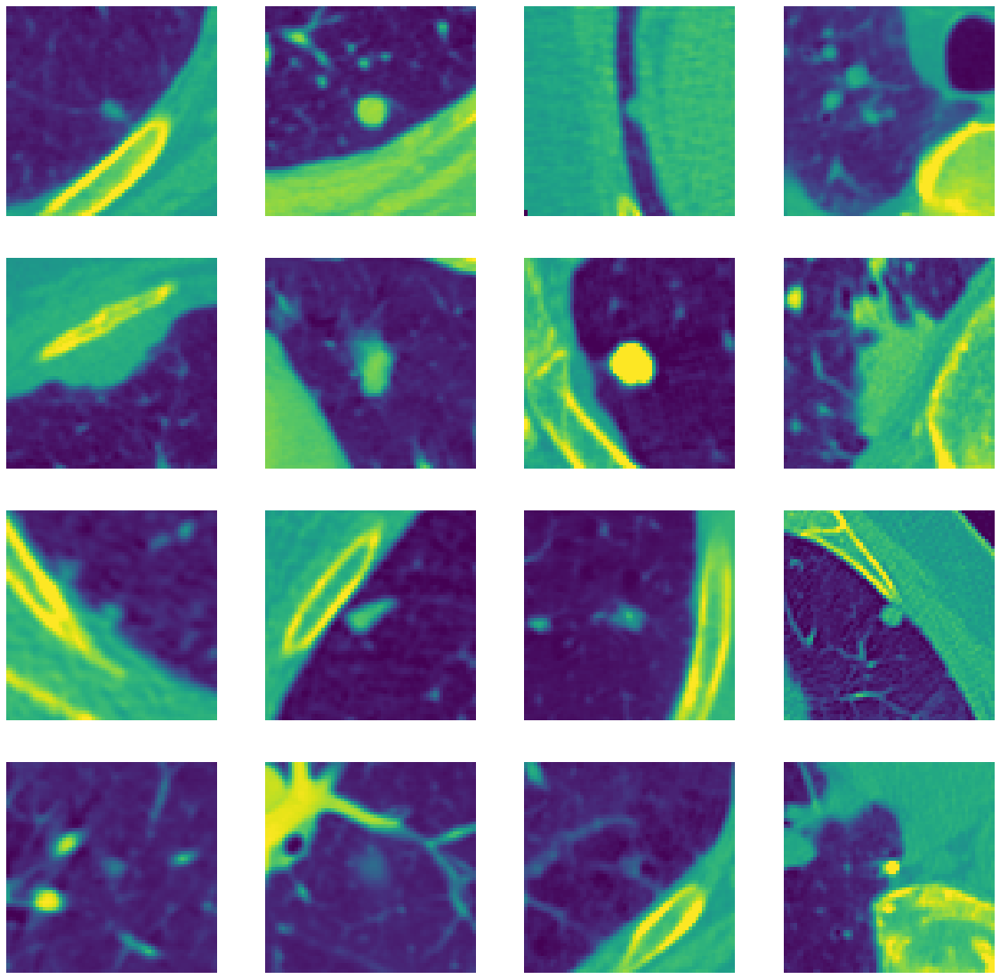

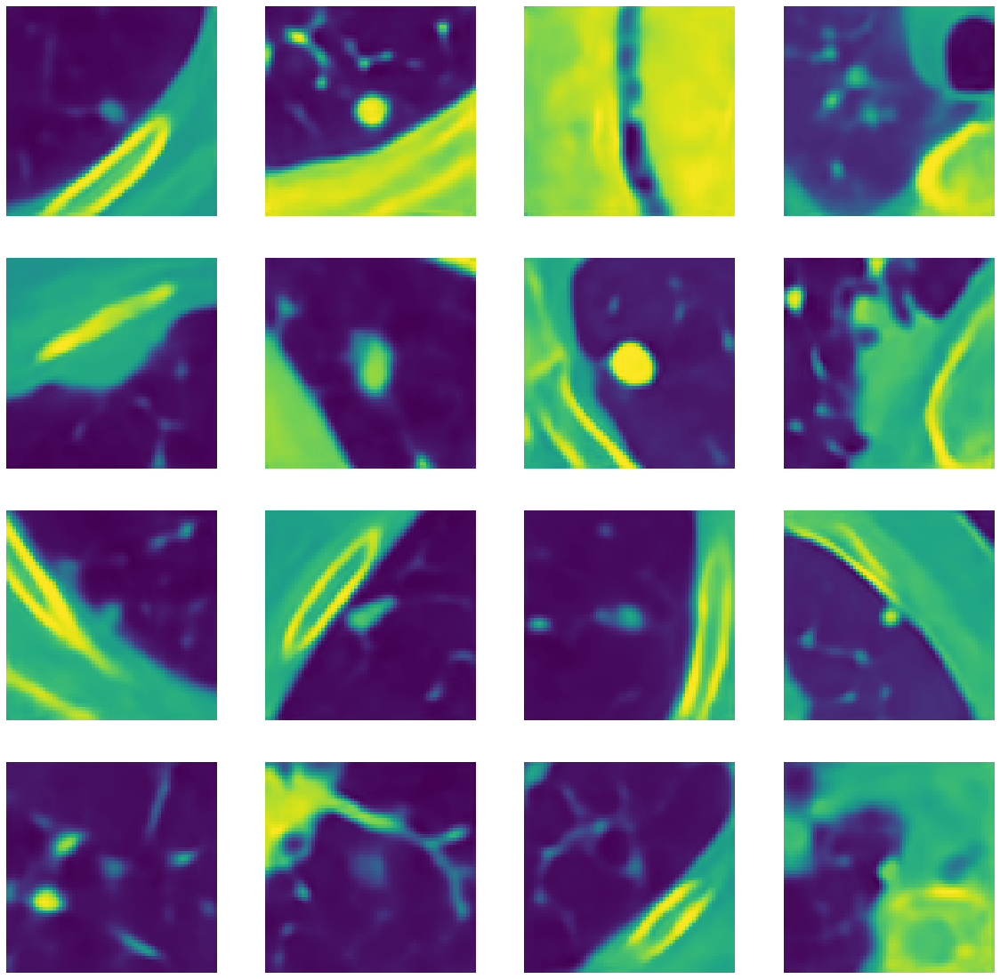

In [6]:
def view_imgs(images, title):
    plt.figure(figsize=(20,20))
    print(len(images))
    for i, image in enumerate(images):
        plt.subplot(4,4,i+1)
        plt.imshow(image, cmap="viridis")
        plt.grid(False)
        plt.axis('off')
    #plt.show()
    results_path = r"C:\Users\mm17b2k\Documents\ARCANE\VAE_lung_lesion_paper\Python\Input_recon_images"
    plt.savefig(results_path + '/' + title, transparent=True)




imgs = []
recons = []
for i in range(16):
    img = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images" + "//" +  random.choice(all_files_list))
    img = pre_process(img)
    imgs.append(torch.squeeze(torch.squeeze(img, dim=0), dim=0))
    with torch.no_grad():
        mu, log_var = model.encode(img)
        reconstruction = model.decode(mu)
        reconstruction = torch.squeeze(torch.squeeze(reconstruction, dim=0), dim=0)
        recons.append(reconstruction)

        #fig = plt.figure()
        #plt.imshow(reconstruction, cmap='viridis')
        #plt.savefig(results_path + '/' + 'step_{}'.format(9) + '.png') #, dpi=100)
    # plt.close()

view_imgs(imgs, "inputs")
view_imgs(recons, "reconstructions")



In [7]:
def interpolation(img1, img2, steps, results_path, example_num):
    img1 = pre_process(img1)
    img2 = pre_process(img2)
    mu_directions = []
    
    with torch.no_grad():
        mu, log_var = model.encode(img1)
        mu2, log_var2 = model.encode(img2)
    
    mu_start = np.array(torch.squeeze(torch.squeeze(torch.squeeze(mu, dim=0), dim=1), dim=1))
    log_var_start = np.array(torch.squeeze(torch.squeeze(torch.squeeze(log_var, dim=0), dim=1), dim=1))
    
    mu_end = np.array(torch.squeeze(torch.squeeze(torch.squeeze(mu2, dim=0), dim=1), dim=1))
    log_var_end = np.array(torch.squeeze(torch.squeeze(torch.squeeze(log_var2, dim=0), dim=1), dim=1))
    
    mu_interpolation, log_var_interpolation = [], []
        
    for t in range(steps+1):
        mu_t = mu_start + ((mu_end - mu_start)*t)/steps
        mu_interpolation.append(mu_t)
        log_var_t = log_var_start + ((log_var_end - log_var_start)*t)/steps
        log_var_interpolation.append(log_var_t)
        mu_directions.append(((mu_end - mu_start)*t)/steps)     
    
    reconstructions = []
    for i, mu in enumerate(mu_interpolation):
        mu = torch.unsqueeze(torch.unsqueeze(torch.unsqueeze(torch.tensor(mu), dim=0), dim=2), dim=2)
        log_var = torch.unsqueeze(torch.unsqueeze(torch.unsqueeze(torch.tensor(log_var_interpolation[i]), dim=0), dim=2), dim=2)
        
        #reparameterised = model.reparameterize(mu,log_var)
        with torch.no_grad():
           # reconstruction = model.decode(reparameterised)
            reconstruction = model.decode(mu)
        reconstruction = torch.squeeze(torch.squeeze(reconstruction, dim=0), dim=0)
        reconstructions.append(np.array(reconstruction))
        #np.save(results_path + '/' + 'step_{}'.format(i), reconstruction)
        recon = np.array(reconstruction)
        fig = plt.figure()
        plt.imshow(reconstruction)
        plt.savefig(results_path + '/' + 'step_{}'.format(i) + '.png') #, dpi=100)
        plt.close()
        
        
    for t in range(steps+1):
        mu_t = mu_end + ((mu_start - mu_end)*t)/steps
        mu_interpolation.append(mu_t)
        log_var_t = log_var_start + ((log_var_end - log_var_start)*t)/steps
        log_var_interpolation.append(log_var_t)
        mu_directions.append(((mu_start - mu_end)*t)/steps)     
    
    for i, mu in enumerate(mu_interpolation[100:]):
        mu = torch.unsqueeze(torch.unsqueeze(torch.unsqueeze(torch.tensor(mu), dim=0), dim=2), dim=2)
        log_var = torch.unsqueeze(torch.unsqueeze(torch.unsqueeze(torch.tensor(log_var_interpolation[i]), dim=0), dim=2), dim=2)
        
        #reparameterised = model.reparameterize(mu,log_var)
        with torch.no_grad():
           # reconstruction = model.decode(reparameterised)
            reconstruction = model.decode(mu)
        reconstruction = torch.squeeze(torch.squeeze(reconstruction, dim=0), dim=0)
        reconstructions.append(np.array(reconstruction))
        #np.save(results_path + '/' + 'step_{}'.format(i), reconstruction)
        recon = np.array(reconstruction)
        fig = plt.figure()
        plt.imshow(reconstruction)
        plt.savefig(results_path + '/' + 'step_{}'.format(i+100) + '.png')
        plt.close()
    
    files_list = ["step_{}.png".format(i) for i in range(2*steps+2)]
    images = []
    for filename in files_list:
        images.append(imageio.imread(results_path + "/" + filename))
    imageio.mimsave(results_path + "/" + "Ex{}.gif".format(example_num), images)
    
    view_images(reconstructions, 'example_{}'.format(example_num))
    return reconstructions, mu_directions
    

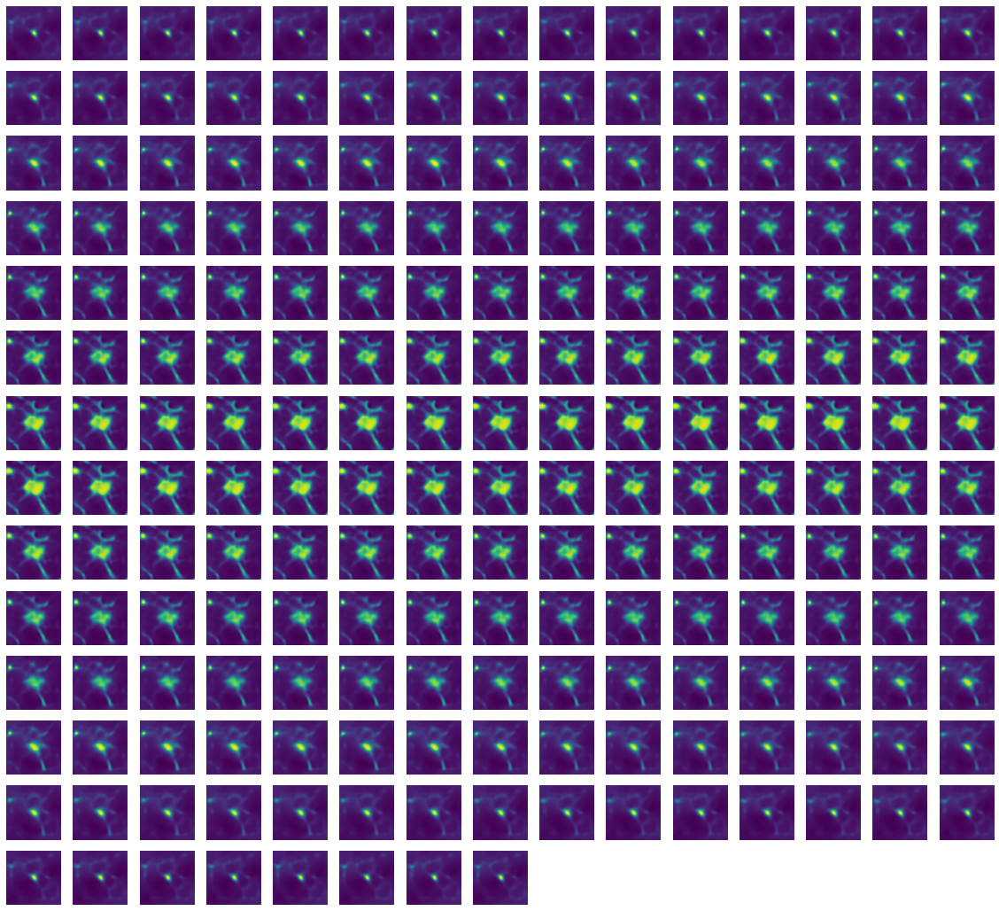

In [25]:
image1 = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images\0106_NI004_slice000.npy")
image2 = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images\1007_NI001_slice002.npy")
path = r"C:\Users\mm17b2k\Documents\ARCANE\VAE_lung_lesion_paper\Python\Latent_results\Gaussian\Example1"

reconstructions, mu_directions_bigger_tumour = interpolation(image1, image2, 100, path, 1)

201


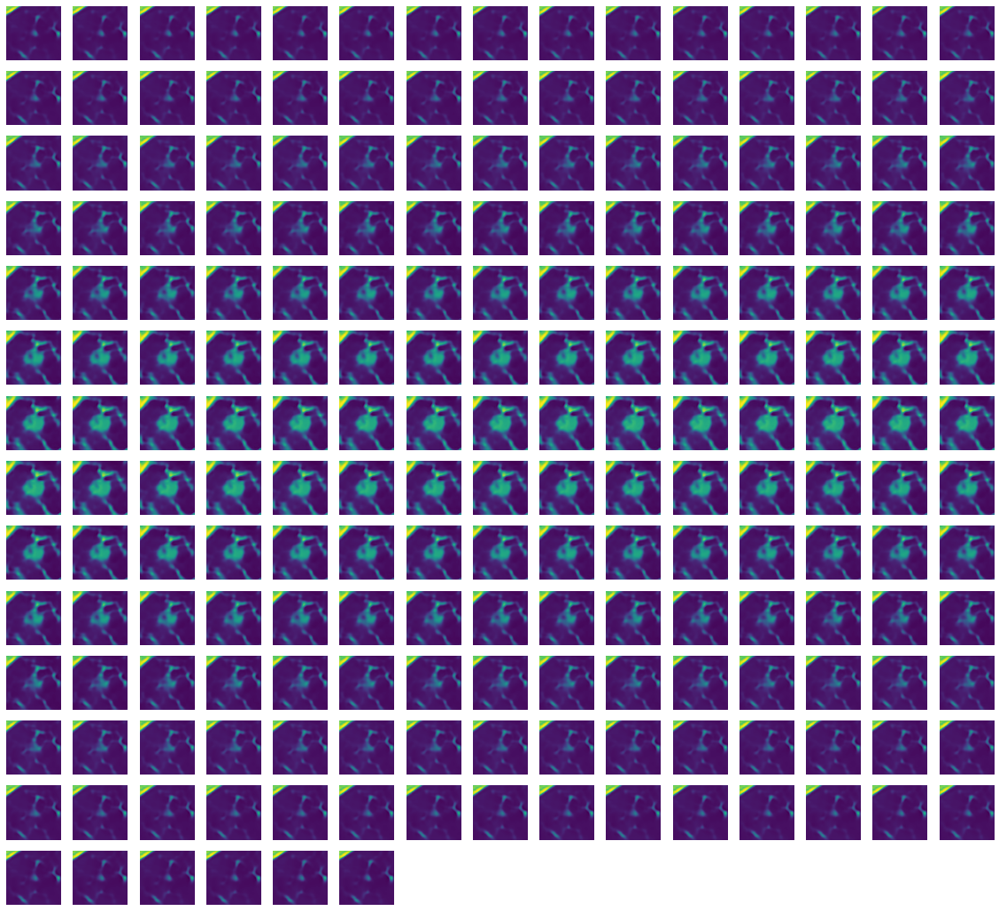

In [27]:
results_path = r"C:\Users\mm17b2k\Documents\ARCANE\VAE_lung_lesion_paper\Python\Latent_results\Gaussian\Example2"
img = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images\0969_NI000_slice001.npy")
steps = 100
example_num = 2
img = pre_process(img)
with torch.no_grad():
    mu, log_var = model.encode(img)

mu_start = np.array(torch.squeeze(torch.squeeze(torch.squeeze(mu, dim=0), dim=1), dim=1))

mu_interpolation1, mu_interpolation = [], []
for t in range(steps+1):
    mu_t = mu_start + mu_directions_bigger_tumour[t]
    mu_interpolation1.append(mu_t)
    if t == steps+1:
        mu_end = mu_t

    
for t in range(2*steps+1):
    if t < 101:
        #print(t)
        mu_interpolation.append(mu_interpolation1[t])
    if t > 100:
        #print(100-t)
        mu_interpolation.append(mu_interpolation1[100-t])
    
print(len(mu_interpolation))

reconstructions = []
for i, mu in enumerate(mu_interpolation):
    mu = torch.unsqueeze(torch.unsqueeze(torch.unsqueeze(torch.tensor(mu), dim=0), dim=2), dim=2)

    with torch.no_grad():
        reconstruction = model.decode(mu)
    reconstruction = torch.squeeze(torch.squeeze(reconstruction, dim=0), dim=0)
    reconstructions.append(np.array(reconstruction))
    #np.save(results_path + '/' + 'step_{}'.format(i), reconstruction)
    recon = np.array(reconstruction)
    fig = plt.figure()
    plt.imshow(reconstruction)
    plt.savefig(results_path + '/' + 'step_{}'.format(i) + '.png') #, dpi=100)
    plt.close()
    
images = []
files_list = ["step_{}.png".format(i) for i in range(2*steps+1)]
for filename in files_list:
    images.append(imageio.imread(results_path + "/" + filename))
imageio.mimsave(results_path + "/" + "Ex{}.gif".format(example_num), images)

view_images(reconstructions, 'example_{}'.format(example_num))

In [28]:
meta = pd.read_csv(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Meta\meta_info.csv")
#meta[-100:-50]
#meta[50:100]

In [29]:
def print_img(all_files):
    plt.figure(figsize=(20,20))
    files = []
    for file in all_files:
        if len(files) < 25:
            files.append(file)
        if len(files) == 25:     
            print(files)
            for i, image in enumerate(files):
                plt.subplot(5,5,i+1)
                img = np.load(IMAGE_DIR+'/'+image)
                plt.imshow(img)
                plt.grid()
            plt.show()
            files = []

In [110]:
small_tumours = ['0006_NI002_slice000.npy','0011_NI001_slice001.npy','0012_NI003_slice000.npy','0012_NI003_slice003.npy','0018_NI002_slice001.npy','0021_NI002_slice004.npy','0031_NI002_slice001.npy']
big_tumours = ['0007_NI000_slice007.npy','0013_NI002_slice005.npy','0016_NI000_slice002.npy','0016_NI005_slice003.npy','0018_NI003_slice002.npy','0044_NI002_slice004.npy','0044_NI002_slice006.npy']

In [8]:
def find_direction(img1,img2, steps):
    img1 = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images" + "/" + img1)
    img2 = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images" + "/" + img2)

    img1 = pre_process(img1)
    img2 = pre_process(img2)
    mu_directions, mu_interpolation = [], []

    
    with torch.no_grad():
        mu, log_var = model.encode(img1)
        mu2, log_var2 = model.encode(img2)
    
    mu_start = np.array(torch.squeeze(torch.squeeze(torch.squeeze(mu, dim=0), dim=1), dim=1))
    mu_end = np.array(torch.squeeze(torch.squeeze(torch.squeeze(mu2, dim=0), dim=1), dim=1))
        
    for t in range(steps+1):
        mu_t = mu_start + ((mu_end - mu_start)*t)/steps
        mu_interpolation.append(mu_t)
        mu_directions.append(((mu_end - mu_start)*t)/steps)
        
#     reconstructions = []
#     for i, mu in enumerate(mu_interpolation):
#         mu = torch.unsqueeze(torch.unsqueeze(torch.unsqueeze(torch.tensor(mu), dim=0), dim=2), dim=2)
        
#         with torch.no_grad():
#             reconstruction = model.decode(mu)
#         reconstruction = torch.squeeze(torch.squeeze(reconstruction, dim=0), dim=0)
#         reconstructions.append(np.array(reconstruction))
#         recon = np.array(reconstruction)
#         fig = plt.figure()
#         plt.imshow(reconstruction)
#         plt.savefig(results_path + '/' + 'step_{}'.format(i) + '.png') #, dpi=100)
#         plt.close()
#     view_images(reconstructions)
    
    return mu_directions

In [96]:
mu_dirs1 = find_direction("0106_NI004_slice000.npy","1007_NI001_slice002.npy",10)

In [97]:
np.shape(mu_dirs1)
#mu_dirs1

(11, 256)

In [98]:
data = np.array([[[0, 1],[2, 3],[6,8]],
                 [[4, 5],[6, 7],[100,1]],
                 [[8, 9],[10, 11],[0,0]]])
avg_data = []

for k in range(len(data[0])):
    avg_data.append(np.average(data[:,k], axis=0))     
avg_data


[array([4., 5.]), array([6., 7.]), array([35.33333333,  3.        ])]

In [112]:
def find_average_mu_dir(feature_list1, feature_list2, save_loc):
    mu_directions, avg_mu_dirs = [], []
    for i in feature_list1:
        for j in feature_list2:
            direction = find_direction(i,j,100)
            mu_directions.append(direction)
    mu_directions = np.array(mu_directions)
    print(len(mu_directions))
    
    for k in range(len(mu_directions[0])):
        avg_mu_dirs.append(np.average(mu_directions[:,k], axis=0))  
        
    np.save(save_loc, avg_mu_dirs)
    return avg_mu_dirs

In [113]:
avg_mu_dirs = find_average_mu_dir(small_tumours, big_tumours, r"C:\Users\mm17b2k\Documents\ARCANE\VAE_lung_lesion_paper\Python\Latent_results\Gaussian\mu_dirs_bigger_tumour")
print(avg_mu_dirs[0].shape, len(avg_mu_dirs))

49
(256,) 101


In [9]:
meta = pd.read_csv(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Meta\meta_info.csv")

def view_images(images, size, title):
    plt.figure(figsize=(size+10,size+10))
    for i, image in enumerate(images):
        plt.subplot(size, size,i+1)
        plt.imshow(image, cmap="viridis")
        plt.grid(False)
        plt.axis('off')
    plt.savefig(r"C:\Users\mm17b2k\Documents\ARCANE\VAE_lung_lesion_paper\Python\Latent_results\Gaussian\GIF_as_image" + '/' + title, transparent=True )
    plt.show()



def apply_mu_dir(img, mu_dir, results_path, example_num, steps):
    img = pre_process(img)
    with torch.no_grad():
        mu, log_var = model.encode(img)

    mu_start = np.array(torch.squeeze(torch.squeeze(torch.squeeze(mu, dim=0), dim=1), dim=1))

    mu_interpolation1, mu_interpolation = [], []
    for t in range(steps+1):
        mu_t = mu_start + (mu_dir*t)/steps
        mu_interpolation1.append(mu_t)
        if t == steps+1:
            mu_end = mu_t


    for t in range(2*steps+1):
        if t < steps+1:
            mu_interpolation.append(mu_interpolation1[t])
        if t > steps:
            mu_interpolation.append(mu_interpolation1[steps-t])

    reconstructions = []
    for i, mu in enumerate(mu_interpolation):
        mu = torch.unsqueeze(torch.unsqueeze(torch.unsqueeze(torch.tensor(mu), dim=0), dim=2), dim=2)

        with torch.no_grad():
            reconstruction = model.decode(mu)
        if i == steps:
            np.save(results_path + '/' + 'feature_applied_image', reconstruction)

        reconstruction = torch.squeeze(torch.squeeze(reconstruction, dim=0), dim=0)
        reconstructions.append(np.array(reconstruction))
        recon = np.array(reconstruction)
        fig = plt.figure()
        plt.imshow(reconstruction)
        plt.grid(False)
        plt.axis('off')
        plt.savefig(results_path + '/' + 'step_{}'.format(i) + '.png')
        plt.close()

    images = []
    files_list = ["step_{}.png".format(i) for i in range(2*steps+1)]
    for filename in files_list:
        images.append(imageio.imread(results_path + "/" + filename))
    imageio.mimsave(results_path + "/" + "Ex{}.gif".format(example_num), images)
    view_images(reconstructions, int(np.ceil(np.sqrt(2*steps+1))),"example_{}".format(example_num))
    return reconstruction


def apply_mu_dir_oneway(img, mu_dir, results_path, example_num, steps):
    img = pre_process(img)
    with torch.no_grad():
        mu, log_var = model.encode(img)

    mu_start = np.array(torch.squeeze(torch.squeeze(torch.squeeze(mu, dim=0), dim=1), dim=1))

    mu_interpolation = []
    for t in range(steps):
        mu_t = mu_start + 1.5*(mu_dir*t)/steps
        mu_interpolation.append(mu_t)
        #if t == steps+1:
        #    mu_end = mu_t

    reconstructions = []
    for i, mu in enumerate(mu_interpolation):
        mu = torch.unsqueeze(torch.unsqueeze(torch.unsqueeze(torch.tensor(mu), dim=0), dim=2), dim=2)

        with torch.no_grad():
            reconstruction = model.decode(mu)
        if i == steps:
            np.save(results_path + '/' + 'feature_applied_image', reconstruction)

        reconstruction = torch.squeeze(torch.squeeze(reconstruction, dim=0), dim=0)
        #image_list.append(reconstruction)
        reconstructions.append(np.array(reconstruction))
        recon = np.array(reconstruction)
        fig = plt.figure()
        plt.imshow(reconstruction, cmap="viridis")
        plt.grid(False)
        plt.axis('off')
        plt.savefig(results_path + '/' + 'step_{}'.format(i) + '.png')
        plt.close()

    images = []
    files_list = ["step_{}.png".format(i) for i in range(steps+1)]
    for filename in files_list:
        images.append(imageio.imread(results_path + "/" + filename))
    imageio.mimsave(results_path + "/" + "Ex{}.gif".format(example_num), images)

    view_images(reconstructions, int(np.ceil(np.sqrt(steps))), "example_{}".format(example_num))
    #view_imgs(image_list, "tumour_bigger_gif")
    return reconstruction

In [72]:
def get_prediction_from_image(image):
    MLP_model = nn.Sequential(
    nn.Linear(2048,1024),
    nn.GELU(),
    nn.Linear(1024,1024),
    nn.GELU(),
    nn.Linear(1024,256),
    nn.GELU(),
    nn.Linear(256,2), # 1
    nn.Softmax()      # nn.Sigmoid()
    )

    state_path = r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\LIDC\Python Scripts\latent vectors\MLP.pt"

    MLP_model.load_state_dict(torch.load(state_path, map_location=torch.device('cpu'))["state_dict"])
    MLP_model.eval()

    image = torch.tensor(image)
    if image.shape == torch.Size([64,64]):
        image = torch.unsqueeze(torch.unsqueeze(torch.tensor(image), dim=0), dim=0).float()

    img = torch.squeeze(torch.squeeze(image, dim=0), dim=0)

    plt.figure(figsize=(10,10))
    plt.imshow(img)
    plt.show()
    plt.close()

    with torch.no_grad():
        mu, log_var = model.encode(image)

    mu = torch.squeeze(torch.squeeze(mu, dim=2), dim=2)



    prediction = MLP_model(mu)
    print(prediction)

    if prediction[0][0].item() >= 0.5:
        print('Malignant with confidence:', prediction[0][0].item())
        return 1
    else:
        print('Benign with confidence:', prediction[0][1].item())
        return 0


# Apply average of 49 directions small -> big

In [115]:
mu_dir_bigger_tumour = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\VAE_lung_lesion_paper\Python\Latent_results\Gaussian\mu_dirs_bigger_tumour.npy")
mu_dir_bigger_tumour.shape

(101, 256)

In [116]:
results_path = r"C:\Users\mm17b2k\Documents\ARCANE\VAE_lung_lesion_paper\Python\Latent_results\Gaussian\Example_bigger_tumour"
img = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images\0969_NI000_slice001.npy")
mu_dir_bigger_tumour = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\VAE_lung_lesion_paper\Python\Latent_results\Gaussian\mu_dirs_bigger_tumour.npy")


#apply_mu_dir(img, mu_dir_bigger_tumour, results_path, 1)

reconstruction = apply_mu_dir_oneway(img, mu_dir_bigger_tumour, results_path, 1, 16)

label = meta[meta['original_image'] == "0969_NI000_slice001"]["malignancy"].item()
print("True Label:", label)

#print('Prediction Before Transformation')
#prediction_before = get_prediction_from_image(img)

#print('Prediction After Transformation')
#prediction_after = get_prediction_from_image(reconstruction)


RuntimeError: Expected 3D (unbatched) or 4D (batched) input to conv2d, but got input of size: [1, 101, 1, 1, 256]

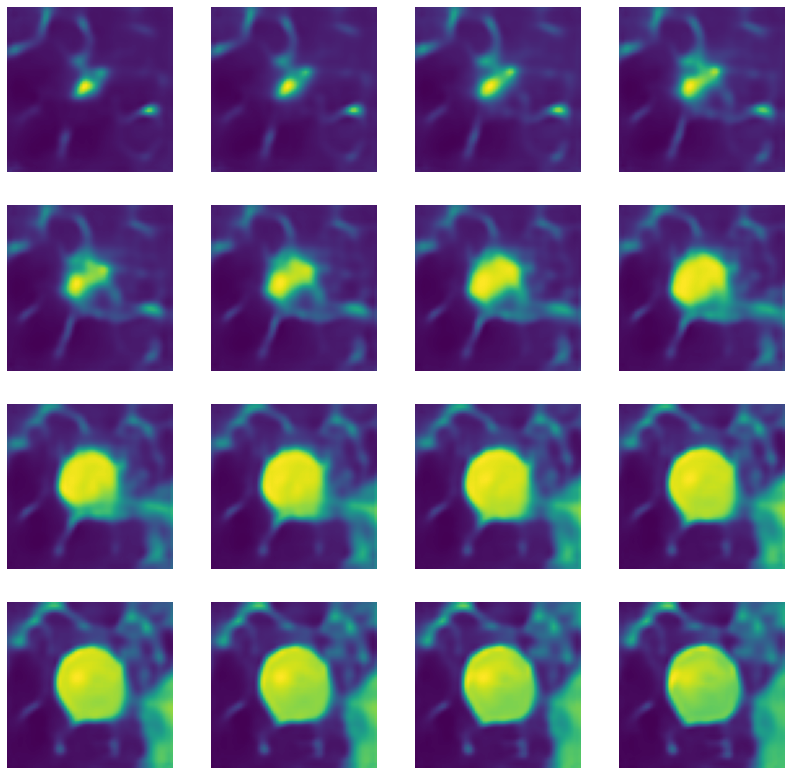

True Label: 2


In [85]:
results_path = results_path = r"C:\Users\mm17b2k\Documents\ARCANE\VAE_lung_lesion_paper\Python\Latent_results\Gaussian\Example_bigger_tumour2"
img = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images\0049_NI013_slice002.npy")

#apply_mu_dir(img, mu_dir_bigger_tumour, results_path, 2)

reconstruction = apply_mu_dir_oneway(img, mu_dir_bigger_tumour, results_path, 2, 16)

label = meta[meta['original_image'] == "0049_NI013_slice002"]["malignancy"].item()
print("True Label:", label)

#print('Prediction Before Transformation')
#prediction_before = get_prediction_from_image(img)

#print('Prediction After Transformation')
#prediction_after = get_prediction_from_image(reconstruction)

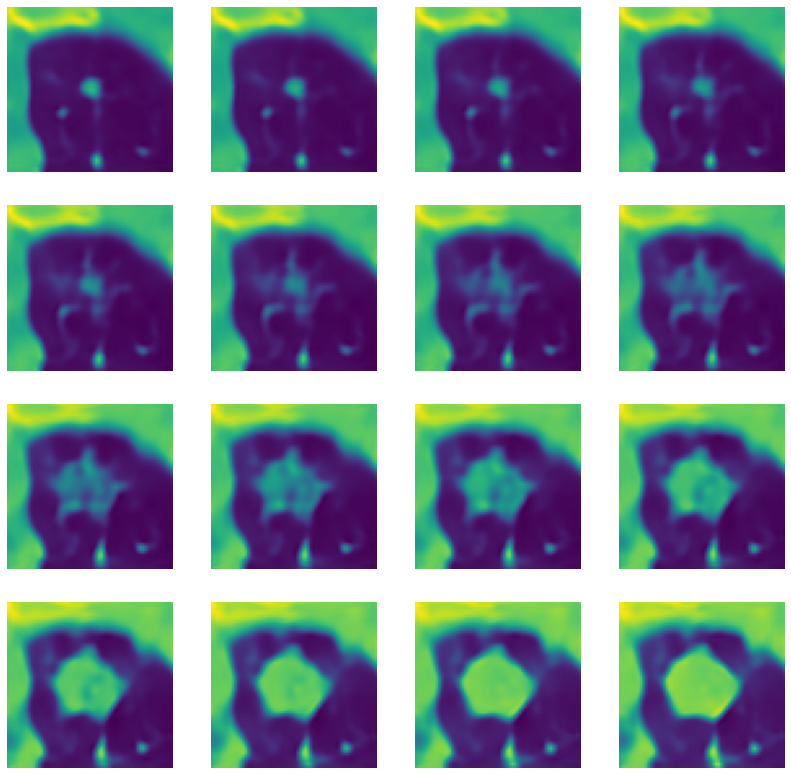

True Label: 3


In [119]:
results_path = r"C:\Users\mm17b2k\Documents\ARCANE\VAE_lung_lesion_paper\Python\Latent_results\Gaussian\Example_bigger_tumour3"
img = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images\0027_NI004_slice002.npy")

#apply_mu_dir(img, mu_dir_bigger_tumour, results_path, 3)

reconstruction = apply_mu_dir_oneway(img, mu_dir_bigger_tumour, results_path, 3, 16)

label = meta[meta['original_image'] == "0027_NI004_slice002"]["malignancy"].item()
print("True Label:", label)

#print('Prediction Before Transformation')
#prediction_before =get_prediction_from_image(img)

#print('Prediction After Transformation')
#prediction_after = get_prediction_from_image(reconstruction)

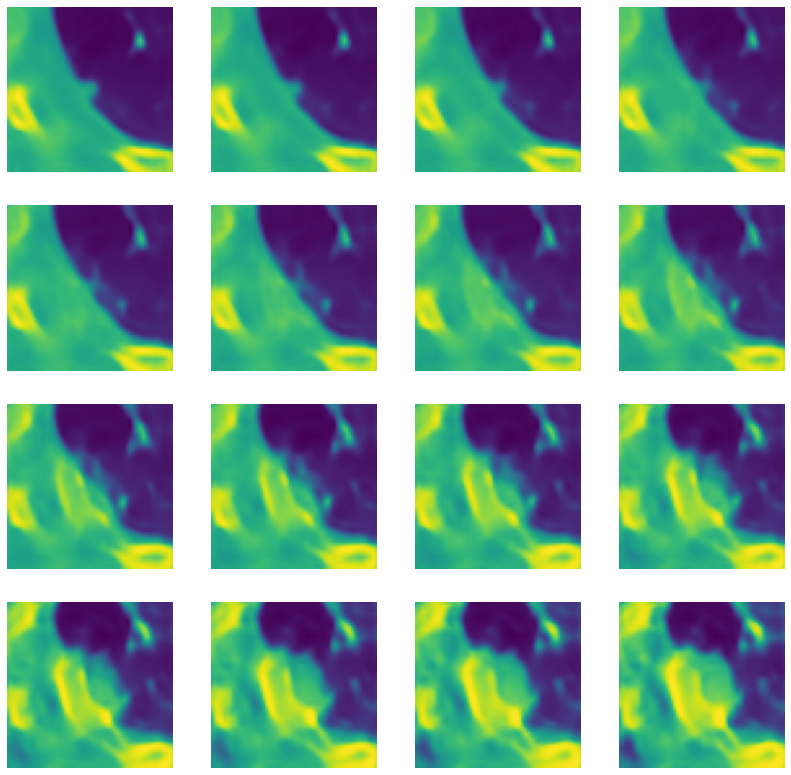

True Label: 3


In [87]:
results_path = r"C:\Users\mm17b2k\Documents\ARCANE\VAE_lung_lesion_paper\Python\Latent_results\Gaussian\Example_bigger_tumour4"
img = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images\0041_NI001_slice001.npy")

#apply_mu_dir(img, mu_dir_bigger_tumour, results_path, 4)

reconstruction = apply_mu_dir_oneway(img, mu_dir_bigger_tumour, results_path, 4, 16)

label = meta[meta['original_image'] == "0041_NI001_slice001"]["malignancy"].item()
print("True Label:", label)

#print('Prediction Before Transformation')
#prediction_before =get_prediction_from_image(img)

#print('Prediction After Transformation')
#prediction_after = get_prediction_from_image(reconstruction)

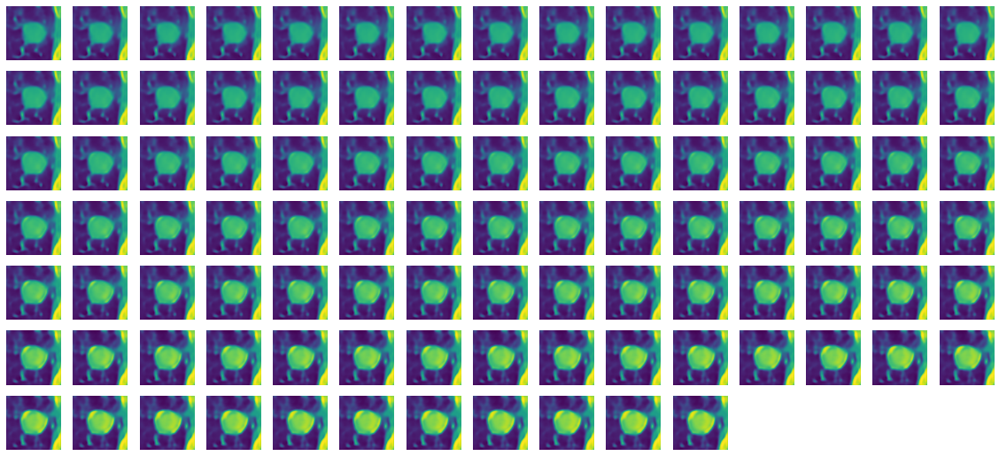

True Label: 4


In [48]:
results_path = r"C:\Users\mm17b2k\Documents\ARCANE\VAE_lung_lesion_paper\Python\Latent_results\Gaussian\Example_bigger_tumour4"
img = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images\0053_NI000_slice003.npy")

#apply_mu_dir(img, mu_dir_bigger_tumour, results_path, 5)

reconstruction = apply_mu_dir_oneway(img, mu_dir_bigger_tumour, results_path, 5)

label = meta[meta['original_image'] == "0053_NI000_slice003"]["malignancy"].item()
print("True Label:", label)

#print('Prediction Before Transformation')
#prediction_before =get_prediction_from_image(img)

#print('Prediction After Transformation')
#prediction_after = get_prediction_from_image(reconstruction)

In [ ]:
image = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\LIDC\Python Scripts\Latent Space Exploration\Example1\feature_applied_image.npy")
get_prediction_from_image(image)

In [ ]:
image = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\LIDC\Python Scripts\Latent Space Exploration\Example2\feature_applied_image.npy")
get_prediction_from_image(image)

In [ ]:
image = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images\0001_NI000_slice006.npy")
get_prediction_from_image(image)

In [ ]:
image = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images\1005_NI000_slice003.npy")
get_prediction_from_image(image)

In [ ]:
image = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images\0005_NI000_slice001.npy")
get_prediction_from_image(image)

In [ ]:
# loop through images randomly to find pairs
# run model on pairs and see if malignancy classification changes and review

In [ ]:
def sample_direction():
    suspect_transformations = []
    for i in range(100):
        img1 = random.choice(all_files_list)
        label1 =  meta[meta['original_image'] == img1[:-4]]["malignancy"].item()
        img2 = random.choice(all_files_list)
        label2 = meta[meta['original_image'] == img2[:-4]]["malignancy"].item()
        img3 = random.choice(all_files_list)
        label3 = meta[meta['original_image'] == img3[:-4]]["malignancy"].item()

        print('Example {}'.format(i))
        print('1:',img1, "malignancy label:", label1)
        print('2:',img2, "malignancy label:", label2)
        print('3:',img3, "malignancy label:", label3)

        image3 = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images"+ "/" + img3)

        print('Random Interpolation')
        mu_direction = find_direction(img1,img2,100)

        print(" ")
        print('Direction Applied to New Image')
        results_path = r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\LIDC\Python Scripts\Latent Space Exploration\Example Random"
        reconstruction = apply_mu_dir_oneway(image3, mu_direction, results_path, i)

        print(" ")
        print('Prediction Before Transformation')
        prediction_before = get_prediction_from_image(image3)
        print("True Label:", label3)

        print(" ")
        print('Prediction After Transformation')
        prediction_after = get_prediction_from_image(reconstruction)

        if prediction_after != label3:
            print("Example {}: This Direction Changed the Prediction".format(i))
            # if mu direction changed the label of the lesion
            if (label1 < 3 and label2 > 3) or (label2 < 3 and label1 > 3):
                suspect_transformations.append([[i, 1], img1, img2, img3])
            # if mu direction did not change label of lesion
            else:
                suspect_transformations.append([[i, 0], img1, img2, img3])

    return suspect_transformations


In [ ]:
suspect_transforms = sample_direction()

In [ ]:
len(suspect_transforms)

In [ ]:
suspect_transforms

In [ ]:
import time

In [ ]:
time.time()

In [35]:
small_tumours = ['0006_NI002_slice000.npy','0011_NI001_slice001.npy','0012_NI003_slice000.npy','0012_NI003_slice003.npy','0018_NI002_slice001.npy','0021_NI002_slice004.npy','0031_NI002_slice001.npy','0407_NI003_slice002.npy', '0648_NI001_slice000.npy', '0648_NI001_slice003.npy', '0648_NI001_slice004.npy', '0648_NI001_slice006.npy', '0648_NI001_slice009.npy', '0648_NI001_slice010.npy', '0648_NI001_slice011.npy','0858_NI002_slice011.npy','0099_NI001_slice002.npy','0984_NI000_slice001.npy']
big_tumours = ['0007_NI000_slice007.npy','0013_NI002_slice005.npy','0016_NI000_slice002.npy','0016_NI005_slice003.npy','0018_NI003_slice002.npy','0044_NI002_slice004.npy','0044_NI002_slice006.npy', '0053_NI000_slice001.npy', '0058_NI002_slice004.npy', '0080_NI001_slice010.npy', '0095_NI000_slice011.npy', '0163_NI000_slice008.npy', '0221_NI000_slice005.npy', '0221_NI000_slice006.npy', '0314_NI000_slice005.npy', '0466_NI001_slice013.npy', '0546_NI000_slice006.npy', '0546_NI000_slice012.npy', '0688_NI002_slice012.npy', '0688_NI002_slice013.npy', '0688_NI002_slice014.npy', '0798_NI002_slice003.npy', '0869_NI001_slice008.npy', '0077_NI000_slice006.npy', '0087_NI000_slice003.npy', '0089_NI000_slice004.npy', '0141_NI000_slice024.npy', '0141_NI000_slice028.npy', '0141_NI000_slice029.npy', '0141_NI000_slice033.npy', '0141_NI000_slice038.npy', '0436_NI000_slice009.npy', '0709_NI001_slice004.npy', '0834_NI000_slice001.npy', '0869_NI001_slice006.npy', '0869_NI001_slice008.npy', '1002_NI000_slice011.npy']


In [36]:
def find_average_latent_vec_direction(feature_list1, feature_list2):
    mu_directions, latent1, latent2 = [], [], []
    for img in feature_list1:
        img = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images" + "/" + img)
        img = pre_process(img)
        with torch.no_grad():
            mu, logvar = model.encode(img)
            latent1.append(np.array(torch.squeeze(torch.squeeze(torch.squeeze(mu, dim=0),dim=1),dim=1)))
    for img in feature_list2:
        img = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images" + "/" + img)
        img = pre_process(img)
        with torch.no_grad():
            mu, logvar = model.encode(img)
            latent2.append(np.array(torch.squeeze(torch.squeeze(torch.squeeze(mu, dim=0),dim=1),dim=1)))
    latent1 = np.stack(latent1)
    latent1 = np.mean(latent1, axis=0)
    latent2 = np.stack(latent2)
    latent2 = np.mean(latent2, axis=0)
    save_loc = r"C:\Users\mm17b2k\Documents\ARCANE\VAE_lung_lesion_paper\Python\Latent_results\Gaussian\mu_dirs_bigger_tumour"
    np.save(save_loc, latent2 - latent1)
    return latent2 - latent1

mu_dir_bigger_tumour = find_average_latent_vec_direction(small_tumours, big_tumours)
mu_dir_bigger_tumour.shape

(256,)

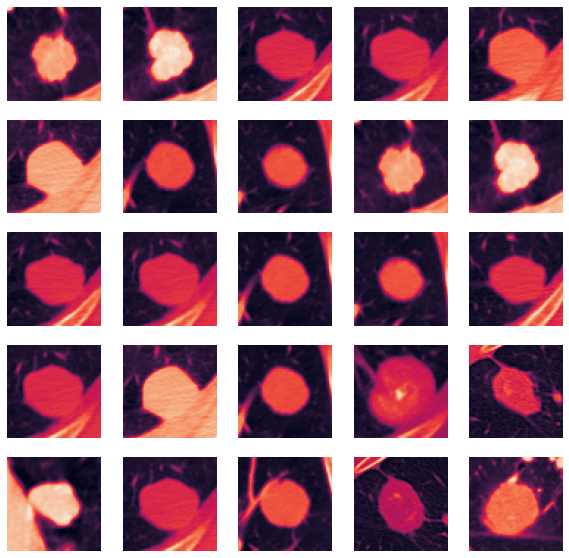

['0044_NI002_slice005.npy', '0044_NI002_slice006.npy', '0061_NI005_slice005.npy', '0061_NI005_slice006.npy', '0061_NI005_slice007.npy', '0061_NI005_slice008.npy', '0064_NI000_slice006.npy', '0064_NI000_slice007.npy', '0044_NI002_slice005.npy', '0044_NI002_slice006.npy', '0061_NI005_slice005.npy', '0061_NI005_slice006.npy', '0064_NI000_slice006.npy', '0064_NI000_slice007.npy', '0061_NI005_slice004.npy', '0061_NI005_slice006.npy', '0061_NI005_slice008.npy', '0064_NI000_slice006.npy', '0127_NI000_slice006.npy', '0141_NI000_slice024.npy', '0294_NI001_slice004.npy', '0061_NI005_slice006.npy', '0064_NI000_slice004.npy', '0141_NI000_slice030.npy', '0266_NI000_slice017.npy']


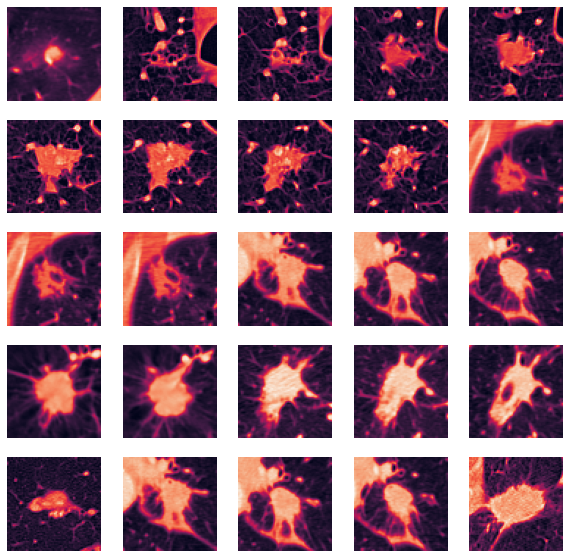

['0003_NI001_slice002.npy', '0007_NI000_slice001.npy', '0007_NI000_slice002.npy', '0007_NI000_slice003.npy', '0007_NI000_slice004.npy', '0007_NI000_slice007.npy', '0007_NI000_slice008.npy', '0007_NI000_slice009.npy', '0007_NI000_slice010.npy', '0019_NI000_slice010.npy', '0019_NI000_slice011.npy', '0019_NI000_slice012.npy', '0020_NI000_slice006.npy', '0020_NI000_slice007.npy', '0020_NI000_slice008.npy', '0050_NI000_slice004.npy', '0050_NI000_slice005.npy', '0072_NI000_slice009.npy', '0072_NI000_slice010.npy', '0072_NI000_slice011.npy', '0094_NI000_slice013.npy', '0020_NI000_slice006.npy', '0020_NI000_slice007.npy', '0020_NI000_slice008.npy', '0058_NI000_slice007.npy']


In [30]:
tumour_without_parenchyma = ['0044_NI002_slice005.npy', '0044_NI002_slice006.npy', '0061_NI005_slice005.npy', '0061_NI005_slice006.npy', '0061_NI005_slice007.npy', '0061_NI005_slice008.npy', '0064_NI000_slice006.npy', '0064_NI000_slice007.npy', '0044_NI002_slice005.npy', '0044_NI002_slice006.npy', '0061_NI005_slice005.npy', '0061_NI005_slice006.npy', '0064_NI000_slice006.npy', '0064_NI000_slice007.npy', '0061_NI005_slice004.npy', '0061_NI005_slice006.npy', '0061_NI005_slice008.npy', '0064_NI000_slice006.npy', '0127_NI000_slice006.npy', '0141_NI000_slice024.npy', '0294_NI001_slice004.npy', '0061_NI005_slice006.npy', '0064_NI000_slice004.npy', '0141_NI000_slice030.npy', '0266_NI000_slice017.npy']
files_list = []
for i in range(25):
    files_list.append(tumour_without_parenchyma[i])
view_img(files_list)

tumour_with_parenchyma = ['0003_NI001_slice002.npy', '0007_NI000_slice001.npy', '0007_NI000_slice002.npy', '0007_NI000_slice003.npy', '0007_NI000_slice004.npy', '0007_NI000_slice007.npy', '0007_NI000_slice008.npy', '0007_NI000_slice009.npy', '0007_NI000_slice010.npy', '0019_NI000_slice010.npy', '0019_NI000_slice011.npy', '0019_NI000_slice012.npy', '0020_NI000_slice006.npy', '0020_NI000_slice007.npy', '0020_NI000_slice008.npy', '0050_NI000_slice004.npy', '0050_NI000_slice005.npy', '0072_NI000_slice009.npy', '0072_NI000_slice010.npy', '0072_NI000_slice011.npy', '0094_NI000_slice013.npy', '0020_NI000_slice006.npy', '0020_NI000_slice007.npy', '0020_NI000_slice008.npy', '0058_NI000_slice007.npy', '0058_NI000_slice008.npy', '0072_NI000_slice010.npy', '0072_NI000_slice011.npy']
files_list = []
for i in range(25):
    files_list.append(tumour_with_parenchyma[i])
view_img(files_list)

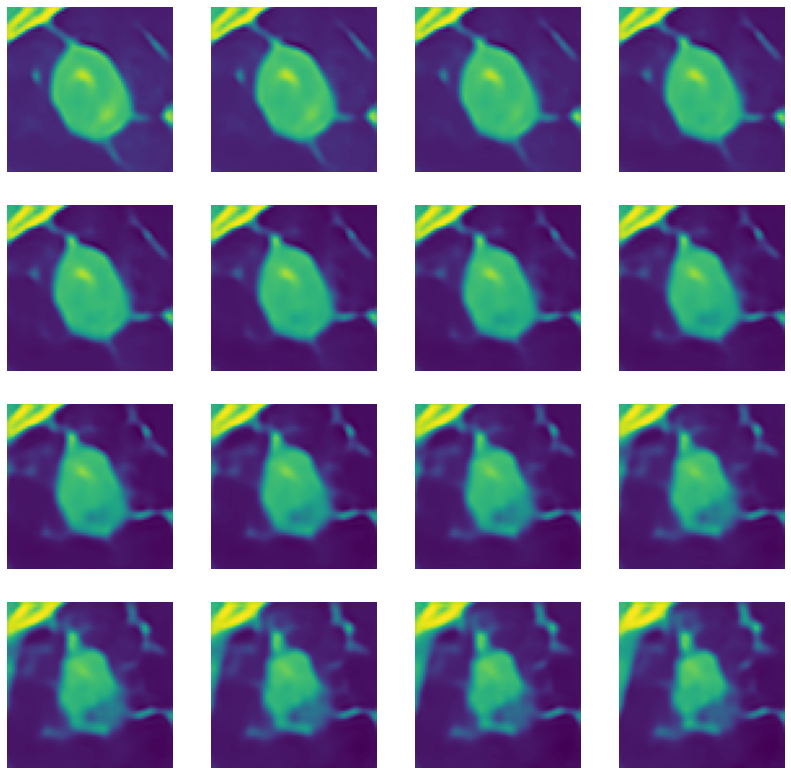

True Label: 4


In [42]:
tumour_with_parenchyma = ['0003_NI001_slice002.npy', '0007_NI000_slice001.npy', '0007_NI000_slice002.npy', '0007_NI000_slice003.npy', '0007_NI000_slice004.npy', '0007_NI000_slice007.npy', '0007_NI000_slice008.npy', '0007_NI000_slice009.npy', '0007_NI000_slice010.npy', '0019_NI000_slice010.npy', '0019_NI000_slice011.npy', '0019_NI000_slice012.npy', '0020_NI000_slice006.npy', '0020_NI000_slice007.npy', '0020_NI000_slice008.npy', '0050_NI000_slice004.npy', '0050_NI000_slice005.npy', '0072_NI000_slice009.npy', '0072_NI000_slice010.npy', '0072_NI000_slice011.npy', '0094_NI000_slice013.npy', '0020_NI000_slice006.npy', '0020_NI000_slice007.npy', '0020_NI000_slice008.npy', '0058_NI000_slice007.npy', '0058_NI000_slice008.npy', '0072_NI000_slice010.npy', '0072_NI000_slice011.npy']

tumour_without_parenchyma = ['0044_NI002_slice005.npy', '0044_NI002_slice006.npy', '0061_NI005_slice005.npy', '0061_NI005_slice006.npy', '0061_NI005_slice007.npy', '0061_NI005_slice008.npy', '0064_NI000_slice006.npy', '0064_NI000_slice007.npy', '0044_NI002_slice005.npy', '0044_NI002_slice006.npy', '0061_NI005_slice005.npy', '0061_NI005_slice006.npy', '0064_NI000_slice006.npy', '0064_NI000_slice007.npy', '0061_NI005_slice004.npy', '0061_NI005_slice006.npy', '0061_NI005_slice008.npy', '0064_NI000_slice006.npy', '0127_NI000_slice006.npy', '0141_NI000_slice024.npy', '0294_NI001_slice004.npy', '0061_NI005_slice006.npy', '0064_NI000_slice004.npy', '0141_NI000_slice030.npy', '0266_NI000_slice017.npy']

results_path = r"C:\Users\mm17b2k\Documents\ARCANE\VAE_lung_lesion_paper\Python\Latent_results\Gaussian\Example1"
img = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images\0141_NI000_slice030.npy")

mu_dir_add_parenchyma = find_average_latent_vec_direction(tumour_without_parenchyma, tumour_with_parenchyma)


reconstruction = apply_mu_dir_oneway(img, mu_dir_add_parenchyma, results_path, 1, 16)

label = meta[meta['original_image'] == "0141_NI000_slice030"]["malignancy"].item()
print("True Label:", label)

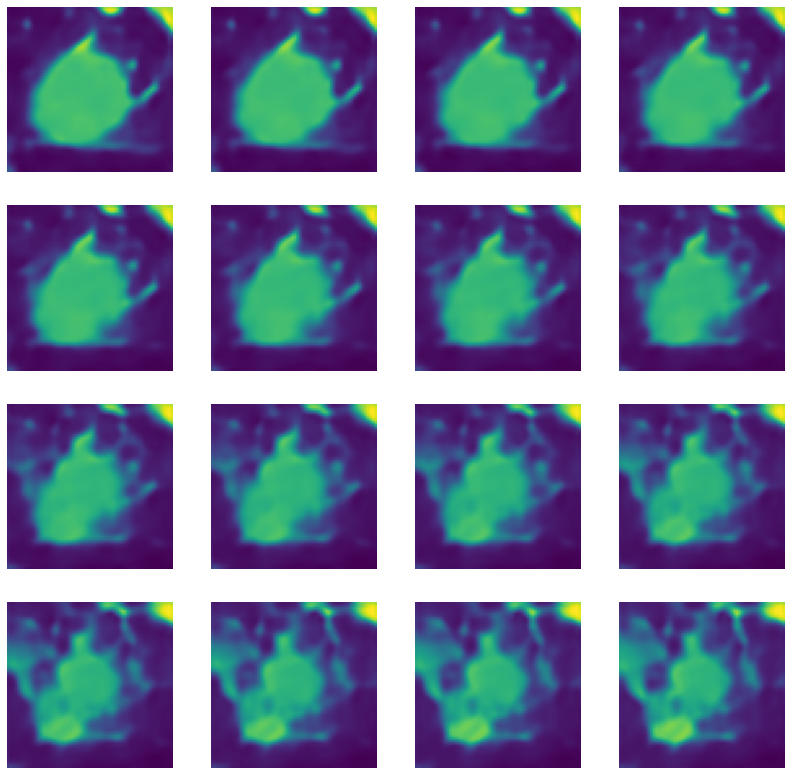

In [48]:
img = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images\0266_NI000_slice017.npy")

reconstruction = apply_mu_dir_oneway(img, mu_dir_add_parenchyma, results_path, 1, 16)

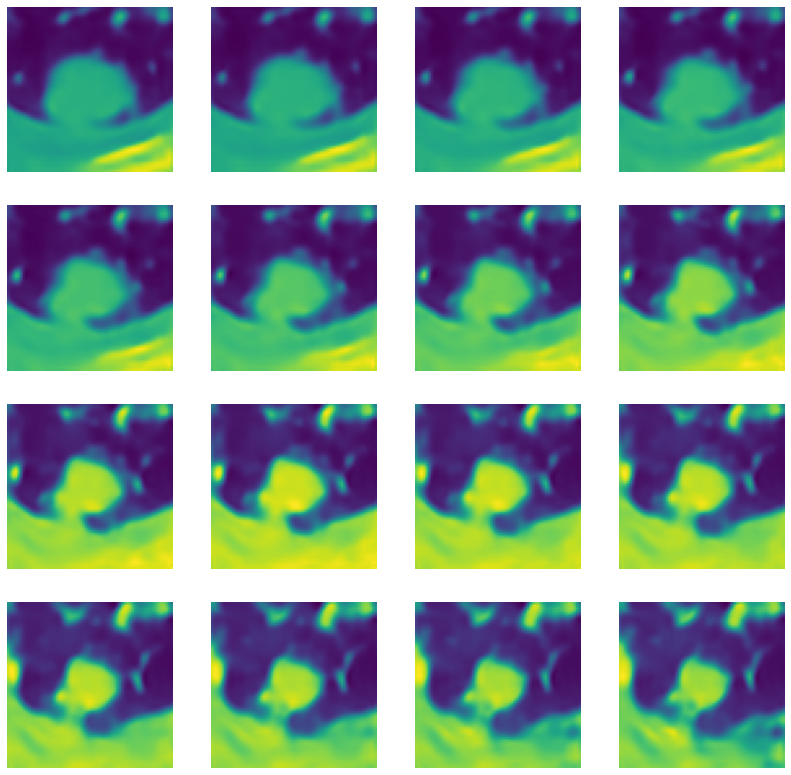

In [56]:
img = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images\0303_NI000_slice008.npy")

reconstruction = apply_mu_dir_oneway(img, mu_dir_add_parenchyma, results_path, 1, 16)

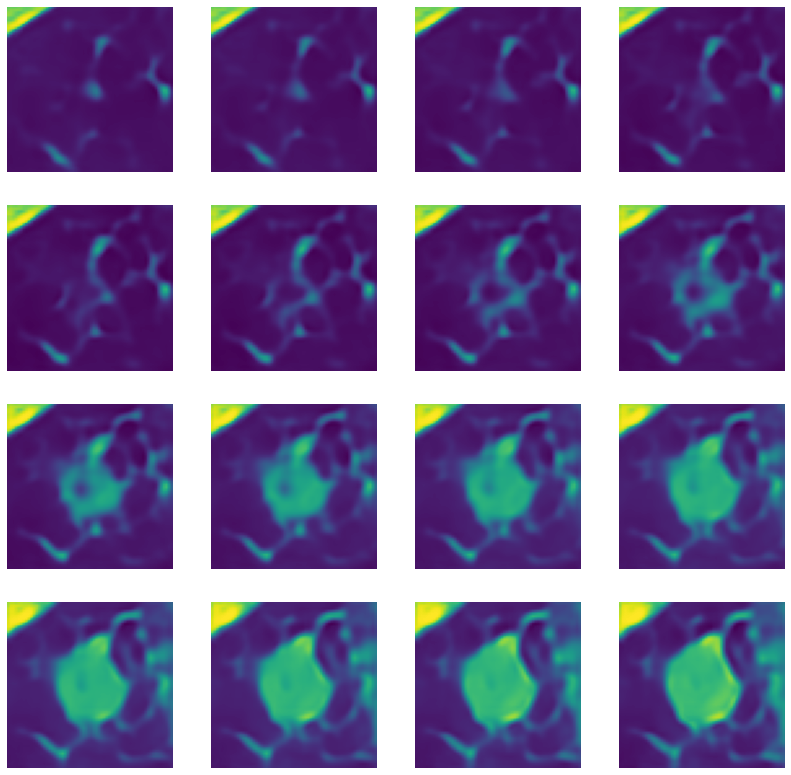

True Label: 3


In [97]:
results_path = r"C:\Users\mm17b2k\Documents\ARCANE\VAE_lung_lesion_paper\Python\Latent_results\Gaussian\Example1"
img = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images\0969_NI000_slice001.npy")

mu_dir_bigger_tumour = find_average_latent_vec_direction(small_tumours, big_tumours)


reconstruction = apply_mu_dir_oneway(img, mu_dir_bigger_tumour, results_path, 1, 16)

label = meta[meta['original_image'] == "0969_NI000_slice001"]["malignancy"].item()
print("True Label:", label)

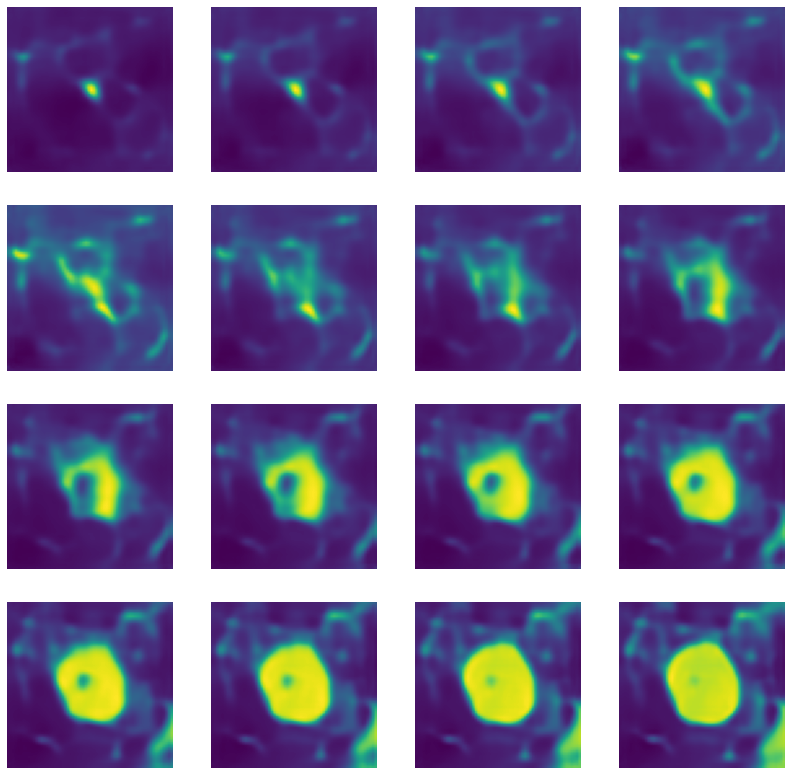

True Label: 1


In [98]:
results_path = r"C:\Users\mm17b2k\Documents\ARCANE\VAE_lung_lesion_paper\Python\Latent_results\Gaussian\Example2"
img = np.load(r"C:\Users\mm17b2k\Documents\ARCANE\Python\MSc\Data\Images\0106_NI004_slice000.npy")
reconstruction = apply_mu_dir_oneway(img, mu_dir_bigger_tumour, results_path, 2, 16)
label = meta[meta['original_image'] == "0106_NI004_slice000"]["malignancy"].item()
print("True Label:", label)

In [13]:
def view_img(files):
    plt.figure(figsize=(10,10))
    for i, image in enumerate(files):
        plt.subplot(5,5,i+1)
        img = np.load(IMAGE_DIR+'/'+image)
        plt.axis('off')
        plt.imshow(img)
        #plt.grid()
    #plt.savefig(os.path.join(r"C:\Users\mm17b2k\Documents\ARCANE\VAE_lung_lesion_paper\Python\Clustering_examples\Dirichlet", filename))
    plt.show()
    print(files)



In [81]:
int(len(all_files_list)/100)

138

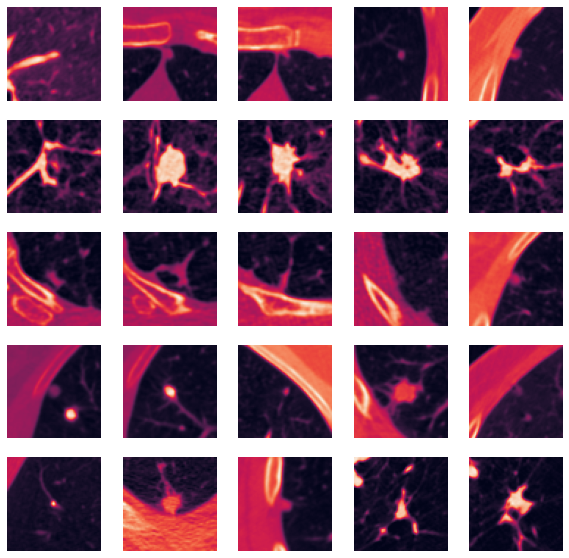

['0604_NI004_slice005.npy', '0604_NI005_slice007.npy', '0604_NI005_slice014.npy', '0605_NI001_slice001.npy', '0605_NI004_slice001.npy', '0606_NI000_slice000.npy', '0606_NI000_slice007.npy', '0606_NI000_slice014.npy', '0606_NI000_slice021.npy', '0606_NI000_slice028.npy', '0606_NI001_slice005.npy', '0606_NI001_slice012.npy', '0606_NI001_slice019.npy', '0606_NI002_slice004.npy', '0608_NI000_slice001.npy', '0608_NI000_slice008.npy', '0608_NI001_slice005.npy', '0608_NI003_slice001.npy', '0608_NI005_slice005.npy', '0609_NI000_slice001.npy', '0609_NI001_slice004.npy', '0610_NI001_slice002.npy', '0613_NI000_slice004.npy', '0614_NI000_slice004.npy', '0614_NI000_slice011.npy']


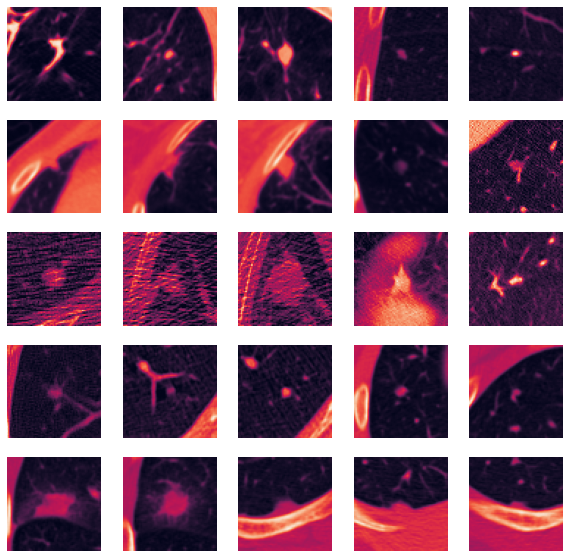

['0614_NI000_slice018.npy', '0614_NI001_slice003.npy', '0614_NI002_slice004.npy', '0615_NI000_slice000.npy', '0615_NI001_slice003.npy', '0617_NI000_slice003.npy', '0617_NI001_slice004.npy', '0617_NI001_slice011.npy', '0617_NI002_slice000.npy', '0618_NI000_slice000.npy', '0619_NI000_slice003.npy', '0619_NI001_slice007.npy', '0619_NI001_slice014.npy', '0620_NI000_slice000.npy', '0620_NI000_slice007.npy', '0620_NI003_slice000.npy', '0621_NI000_slice002.npy', '0621_NI000_slice009.npy', '0624_NI000_slice003.npy', '0624_NI002_slice002.npy', '0624_NI003_slice007.npy', '0624_NI003_slice014.npy', '0624_NI004_slice002.npy', '0624_NI005_slice003.npy', '0624_NI005_slice010.npy']


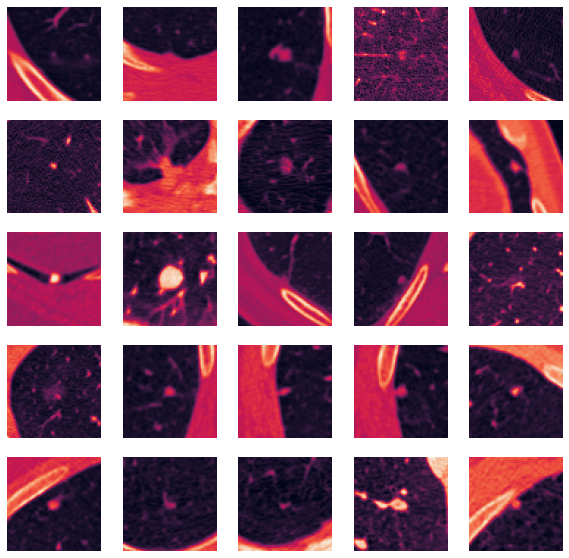

['0624_NI006_slice004.npy', '0624_NI007_slice007.npy', '0625_NI000_slice006.npy', '0626_NI000_slice000.npy', '0628_NI003_slice003.npy', '0628_NI006_slice001.npy', '0629_NI000_slice003.npy', '0629_NI001_slice002.npy', '0631_NI000_slice003.npy', '0633_NI000_slice006.npy', '0634_NI000_slice001.npy', '0635_NI000_slice003.npy', '0636_NI000_slice004.npy', '0636_NI002_slice001.npy', '0636_NI004_slice002.npy', '0636_NI004_slice009.npy', '0637_NI000_slice004.npy', '0637_NI001_slice003.npy', '0637_NI001_slice010.npy', '0637_NI003_slice002.npy', '0637_NI005_slice003.npy', '0637_NI007_slice000.npy', '0637_NI007_slice007.npy', '0637_NI008_slice005.npy', '0637_NI010_slice003.npy']


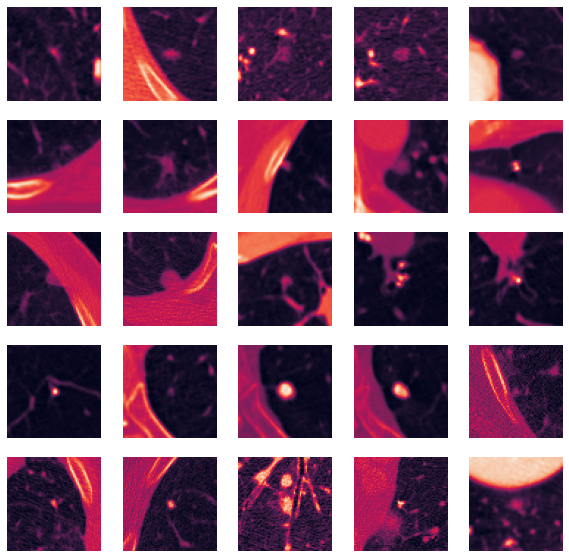

['0638_NI000_slice002.npy', '0639_NI000_slice004.npy', '0639_NI001_slice001.npy', '0639_NI001_slice008.npy', '0640_NI001_slice001.npy', '0641_NI002_slice003.npy', '0641_NI003_slice006.npy', '0641_NI005_slice001.npy', '0642_NI000_slice000.npy', '0642_NI003_slice001.npy', '0643_NI002_slice000.npy', '0645_NI000_slice001.npy', '0647_NI000_slice000.npy', '0648_NI000_slice005.npy', '0648_NI000_slice012.npy', '0648_NI001_slice005.npy', '0648_NI002_slice000.npy', '0648_NI002_slice007.npy', '0648_NI002_slice014.npy', '0649_NI000_slice003.npy', '0649_NI003_slice000.npy', '0649_NI006_slice000.npy', '0649_NI008_slice002.npy', '0649_NI010_slice001.npy', '0651_NI000_slice001.npy']


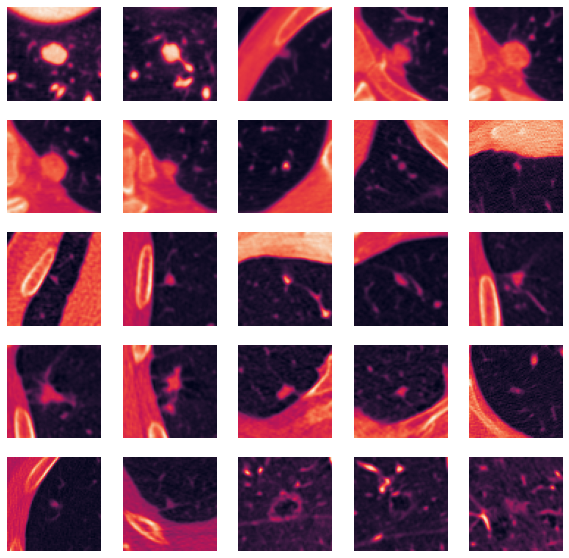

['0651_NI000_slice008.npy', '0651_NI000_slice015.npy', '0651_NI001_slice002.npy', '0651_NI002_slice005.npy', '0651_NI002_slice012.npy', '0651_NI002_slice019.npy', '0651_NI002_slice026.npy', '0651_NI003_slice003.npy', '0652_NI000_slice000.npy', '0654_NI000_slice003.npy', '0655_NI000_slice006.npy', '0655_NI001_slice006.npy', '0655_NI003_slice005.npy', '0655_NI004_slice005.npy', '0655_NI005_slice004.npy', '0655_NI005_slice011.npy', '0655_NI005_slice018.npy', '0655_NI006_slice005.npy', '0655_NI007_slice003.npy', '0656_NI000_slice000.npy', '0656_NI001_slice004.npy', '0657_NI000_slice007.npy', '0659_NI000_slice003.npy', '0659_NI000_slice010.npy', '0659_NI001_slice005.npy']


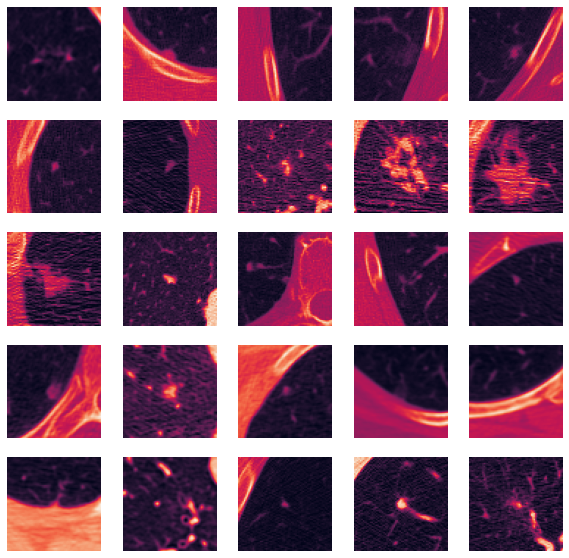

['0659_NI002_slice006.npy', '0660_NI000_slice001.npy', '0660_NI002_slice000.npy', '0660_NI003_slice003.npy', '0660_NI004_slice003.npy', '0660_NI006_slice000.npy', '0661_NI001_slice001.npy', '0661_NI004_slice001.npy', '0661_NI004_slice008.npy', '0661_NI004_slice019.npy', '0661_NI004_slice026.npy', '0662_NI001_slice001.npy', '0662_NI003_slice000.npy', '0662_NI004_slice004.npy', '0663_NI000_slice002.npy', '0663_NI001_slice002.npy', '0663_NI002_slice006.npy', '0664_NI000_slice003.npy', '0666_NI001_slice000.npy', '0666_NI002_slice002.npy', '0666_NI004_slice002.npy', '0670_NI000_slice000.npy', '0671_NI000_slice001.npy', '0671_NI001_slice002.npy', '0671_NI003_slice000.npy']


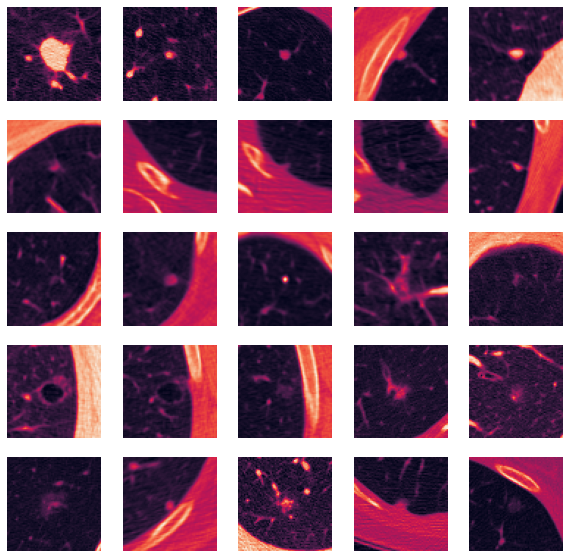

['0671_NI003_slice007.npy', '0671_NI005_slice001.npy', '0671_NI006_slice003.npy', '0672_NI000_slice007.npy', '0673_NI000_slice003.npy', '0673_NI001_slice000.npy', '0673_NI002_slice000.npy', '0673_NI003_slice001.npy', '0673_NI004_slice004.npy', '0674_NI001_slice002.npy', '0674_NI003_slice004.npy', '0676_NI000_slice001.npy', '0677_NI000_slice001.npy', '0678_NI000_slice003.npy', '0680_NI001_slice000.npy', '0681_NI000_slice006.npy', '0681_NI000_slice013.npy', '0681_NI000_slice020.npy', '0682_NI000_slice004.npy', '0682_NI001_slice001.npy', '0682_NI002_slice003.npy', '0684_NI000_slice004.npy', '0686_NI000_slice002.npy', '0686_NI002_slice002.npy', '0686_NI004_slice002.npy']


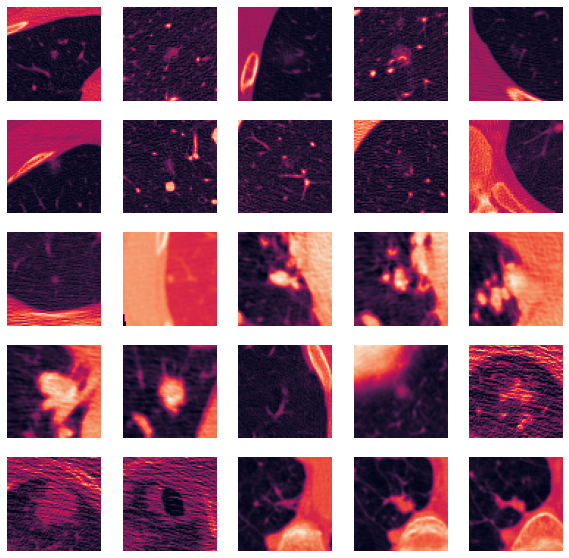

['0686_NI006_slice000.npy', '0686_NI008_slice003.npy', '0686_NI009_slice005.npy', '0686_NI011_slice001.npy', '0686_NI012_slice001.npy', '0686_NI014_slice003.npy', '0686_NI015_slice005.npy', '0686_NI017_slice000.npy', '0686_NI020_slice000.npy', '0687_NI001_slice000.npy', '0687_NI004_slice001.npy', '0688_NI000_slice001.npy', '0688_NI001_slice003.npy', '0688_NI001_slice010.npy', '0688_NI002_slice004.npy', '0688_NI002_slice011.npy', '0688_NI002_slice018.npy', '0693_NI000_slice002.npy', '0695_NI000_slice002.npy', '0697_NI000_slice000.npy', '0697_NI000_slice007.npy', '0697_NI000_slice014.npy', '0698_NI000_slice001.npy', '0698_NI000_slice008.npy', '0698_NI000_slice015.npy']


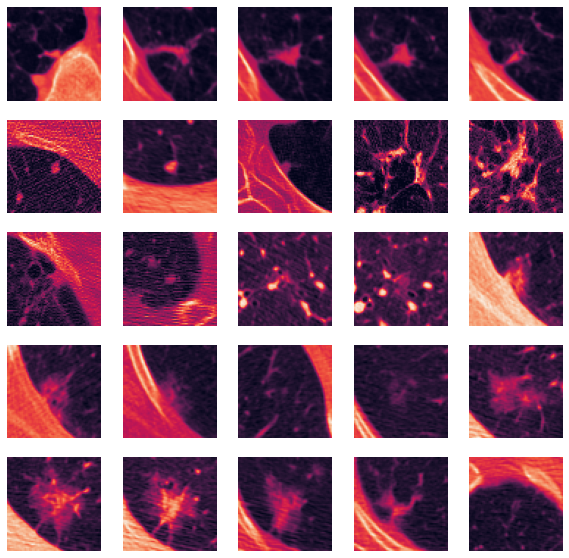

['0698_NI000_slice022.npy', '0698_NI001_slice005.npy', '0698_NI001_slice012.npy', '0698_NI001_slice019.npy', '0698_NI001_slice026.npy', '0699_NI000_slice001.npy', '0700_NI000_slice005.npy', '0701_NI001_slice002.npy', '0701_NI003_slice004.npy', '0701_NI003_slice011.npy', '0701_NI003_slice018.npy', '0701_NI004_slice006.npy', '0702_NI000_slice002.npy', '0702_NI000_slice009.npy', '0702_NI001_slice006.npy', '0702_NI001_slice013.npy', '0702_NI001_slice020.npy', '0702_NI002_slice006.npy', '0702_NI004_slice001.npy', '0702_NI004_slice008.npy', '0702_NI004_slice015.npy', '0702_NI004_slice022.npy', '0702_NI004_slice029.npy', '0702_NI004_slice036.npy', '0702_NI006_slice000.npy']


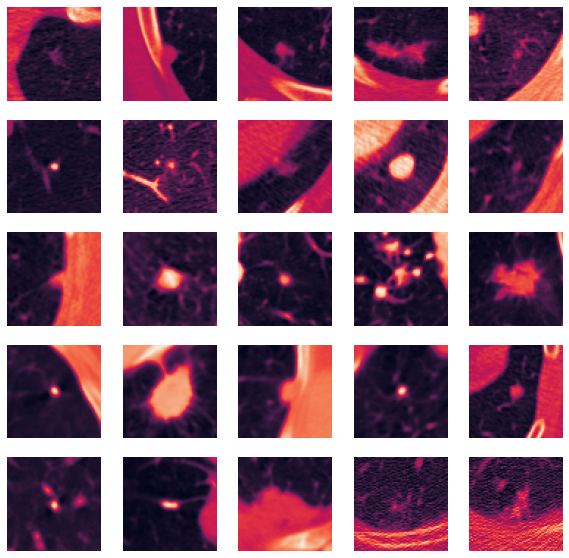

['0702_NI007_slice003.npy', '0703_NI000_slice007.npy', '0703_NI001_slice005.npy', '0703_NI001_slice020.npy', '0703_NI002_slice001.npy', '0704_NI000_slice005.npy', '0704_NI001_slice004.npy', '0705_NI000_slice002.npy', '0705_NI000_slice009.npy', '0705_NI000_slice016.npy', '0705_NI001_slice006.npy', '0706_NI000_slice000.npy', '0707_NI002_slice001.npy', '0707_NI005_slice000.npy', '0708_NI000_slice003.npy', '0709_NI000_slice000.npy', '0709_NI001_slice006.npy', '0709_NI002_slice002.npy', '0709_NI004_slice001.npy', '0712_NI000_slice004.npy', '0713_NI001_slice001.npy', '0713_NI005_slice001.npy', '0713_NI006_slice006.npy', '0714_NI000_slice003.npy', '0714_NI000_slice010.npy']


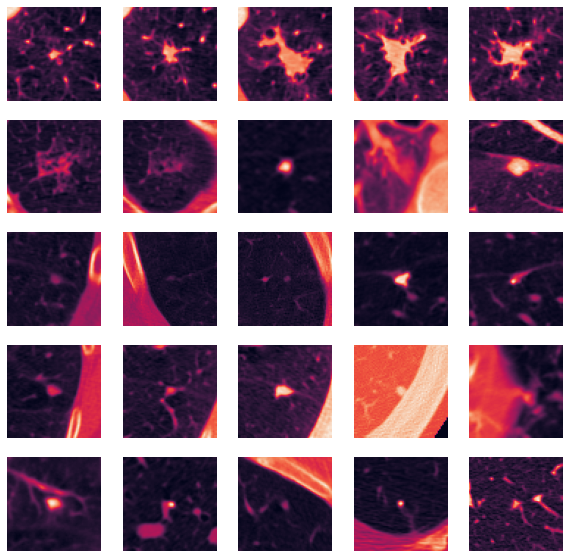

['0715_NI000_slice005.npy', '0715_NI000_slice012.npy', '0715_NI000_slice019.npy', '0715_NI000_slice026.npy', '0715_NI000_slice033.npy', '0715_NI000_slice040.npy', '0715_NI000_slice047.npy', '0717_NI000_slice006.npy', '0719_NI000_slice000.npy', '0720_NI000_slice004.npy', '0720_NI001_slice001.npy', '0721_NI000_slice000.npy', '0721_NI003_slice001.npy', '0722_NI000_slice007.npy', '0722_NI000_slice014.npy', '0722_NI001_slice005.npy', '0722_NI002_slice002.npy', '0722_NI002_slice009.npy', '0723_NI000_slice001.npy', '0724_NI001_slice000.npy', '0724_NI003_slice002.npy', '0726_NI001_slice001.npy', '0727_NI000_slice001.npy', '0727_NI001_slice003.npy', '0729_NI000_slice000.npy']


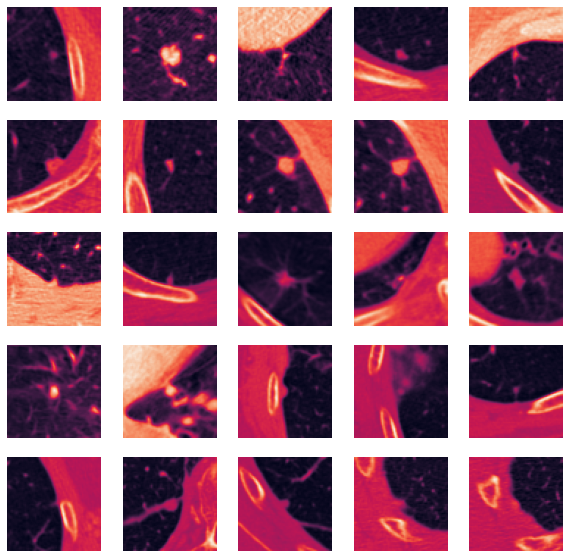

['0732_NI000_slice000.npy', '0732_NI001_slice005.npy', '0733_NI001_slice001.npy', '0733_NI002_slice001.npy', '0733_NI004_slice000.npy', '0733_NI005_slice005.npy', '0733_NI007_slice004.npy', '0734_NI000_slice012.npy', '0734_NI000_slice019.npy', '0735_NI001_slice000.npy', '0735_NI002_slice003.npy', '0739_NI000_slice002.npy', '0740_NI000_slice003.npy', '0741_NI000_slice003.npy', '0741_NI002_slice001.npy', '0741_NI004_slice001.npy', '0741_NI005_slice005.npy', '0742_NI000_slice001.npy', '0742_NI003_slice002.npy', '0742_NI005_slice000.npy', '0742_NI007_slice001.npy', '0742_NI009_slice001.npy', '0742_NI011_slice001.npy', '0742_NI013_slice000.npy', '0742_NI013_slice007.npy']


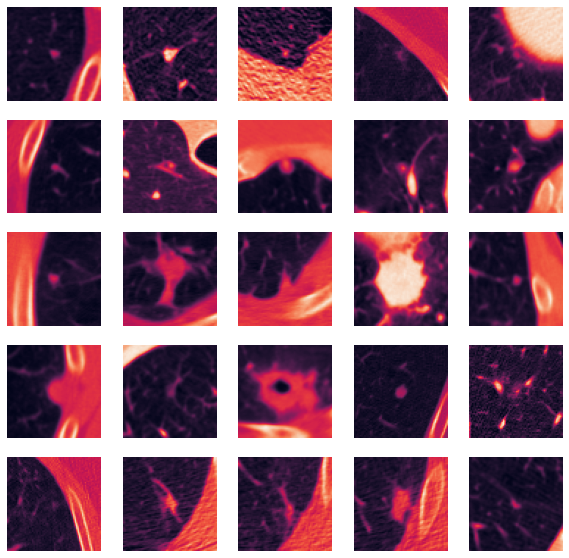

['0743_NI001_slice001.npy', '0744_NI000_slice002.npy', '0744_NI001_slice001.npy', '0747_NI000_slice001.npy', '0748_NI001_slice001.npy', '0748_NI004_slice001.npy', '0748_NI007_slice000.npy', '0749_NI001_slice001.npy', '0749_NI003_slice001.npy', '0749_NI005_slice000.npy', '0750_NI001_slice001.npy', '0750_NI002_slice005.npy', '0750_NI002_slice012.npy', '0751_NI000_slice003.npy', '0751_NI001_slice001.npy', '0751_NI002_slice008.npy', '0751_NI004_slice001.npy', '0751_NI006_slice004.npy', '0752_NI000_slice002.npy', '0752_NI001_slice006.npy', '0754_NI001_slice000.npy', '0756_NI000_slice001.npy', '0756_NI000_slice008.npy', '0756_NI000_slice015.npy', '0757_NI000_slice003.npy']


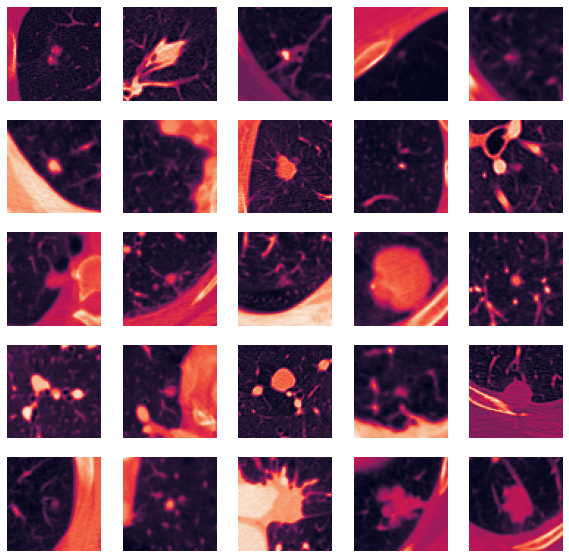

['0094_NI000_slice022.npy', '0095_NI002_slice004.npy', '0099_NI001_slice002.npy', '0105_NI000_slice000.npy', '0107_NI002_slice000.npy', '0110_NI001_slice001.npy', '0111_NI005_slice004.npy', '0116_NI001_slice001.npy', '0118_NI004_slice001.npy', '0119_NI001_slice010.npy', '0120_NI003_slice003.npy', '0123_NI000_slice002.npy', '0124_NI012_slice002.npy', '0127_NI000_slice004.npy', '0129_NI000_slice003.npy', '0129_NI005_slice000.npy', '0129_NI010_slice005.npy', '0130_NI000_slice006.npy', '0132_NI001_slice002.npy', '0133_NI001_slice007.npy', '0135_NI004_slice000.npy', '0136_NI008_slice000.npy', '0138_NI000_slice007.npy', '0139_NI000_slice003.npy', '0139_NI002_slice004.npy']


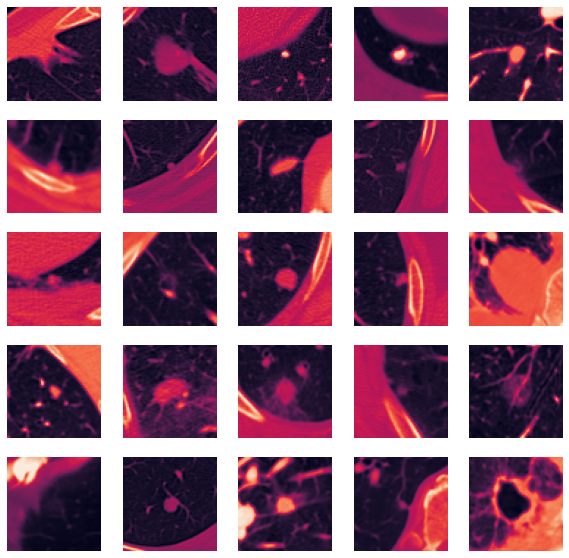

['0141_NI000_slice014.npy', '0141_NI000_slice039.npy', '0142_NI000_slice001.npy', '0144_NI001_slice002.npy', '0146_NI000_slice006.npy', '0147_NI006_slice001.npy', '0149_NI005_slice000.npy', '0153_NI001_slice002.npy', '0157_NI000_slice001.npy', '0158_NI003_slice006.npy', '0161_NI000_slice001.npy', '0162_NI001_slice003.npy', '0164_NI002_slice005.npy', '0164_NI007_slice002.npy', '0166_NI000_slice004.npy', '0168_NI001_slice004.npy', '0170_NI000_slice008.npy', '0171_NI000_slice003.npy', '0173_NI000_slice002.npy', '0179_NI000_slice004.npy', '0179_NI010_slice001.npy', '0181_NI003_slice001.npy', '0182_NI002_slice001.npy', '0185_NI001_slice001.npy', '0186_NI003_slice004.npy']


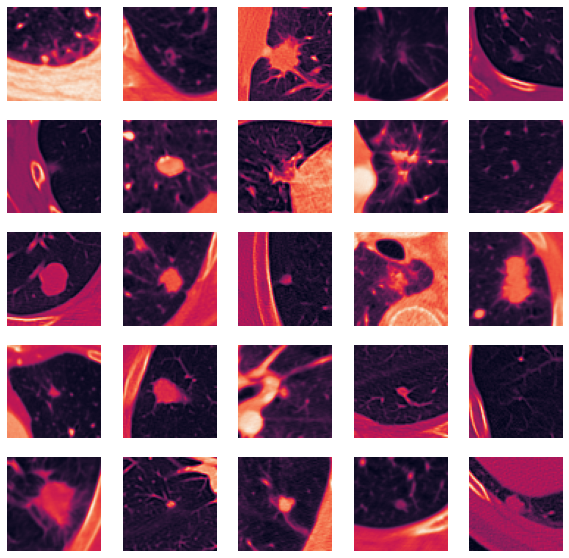

['0188_NI001_slice000.npy', '0188_NI009_slice000.npy', '0191_NI000_slice006.npy', '0194_NI000_slice000.npy', '0195_NI001_slice005.npy', '0195_NI005_slice007.npy', '0199_NI003_slice005.npy', '0201_NI002_slice010.npy', '0203_NI001_slice009.npy', '0206_NI002_slice000.npy', '0209_NI000_slice002.npy', '0211_NI000_slice017.npy', '0216_NI001_slice000.npy', '0220_NI000_slice005.npy', '0221_NI000_slice004.npy', '0223_NI001_slice001.npy', '0229_NI001_slice002.npy', '0230_NI002_slice000.npy', '0235_NI002_slice001.npy', '0240_NI001_slice000.npy', '0242_NI000_slice003.npy', '0247_NI000_slice000.npy', '0250_NI000_slice001.npy', '0255_NI000_slice000.npy', '0259_NI000_slice004.npy']


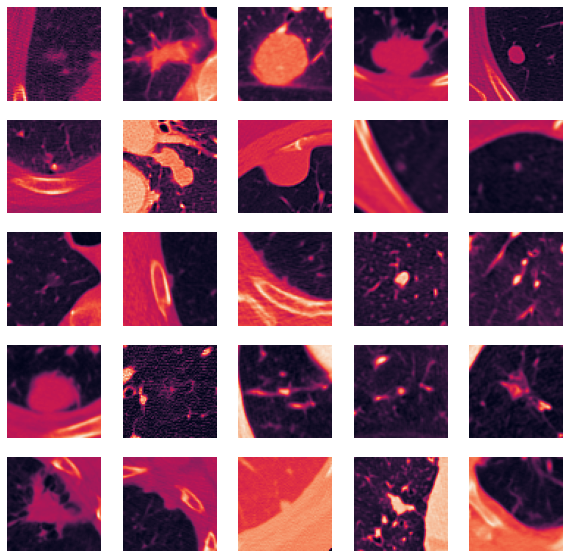

['0262_NI000_slice006.npy', '0265_NI000_slice007.npy', '0266_NI000_slice017.npy', '0267_NI000_slice020.npy', '0274_NI000_slice003.npy', '0281_NI000_slice002.npy', '0285_NI001_slice004.npy', '0289_NI001_slice004.npy', '0294_NI000_slice000.npy', '0297_NI001_slice002.npy', '0298_NI003_slice001.npy', '0299_NI000_slice002.npy', '0299_NI004_slice001.npy', '0300_NI002_slice002.npy', '0301_NI000_slice005.npy', '0303_NI000_slice008.npy', '0305_NI003_slice000.npy', '0308_NI000_slice001.npy', '0308_NI001_slice009.npy', '0309_NI001_slice000.npy', '0311_NI000_slice010.npy', '0311_NI000_slice035.npy', '0312_NI002_slice003.npy', '0314_NI000_slice002.npy', '0315_NI003_slice003.npy']


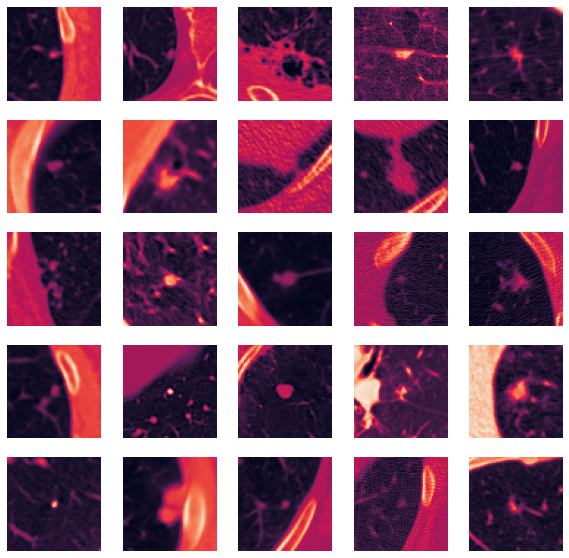

['0320_NI000_slice002.npy', '0323_NI002_slice000.npy', '0325_NI000_slice018.npy', '0329_NI000_slice000.npy', '0332_NI001_slice006.npy', '0334_NI009_slice000.npy', '0337_NI000_slice003.npy', '0340_NI000_slice002.npy', '0340_NI000_slice027.npy', '0341_NI001_slice003.npy', '0344_NI001_slice007.npy', '0345_NI000_slice001.npy', '0347_NI000_slice004.npy', '0350_NI001_slice000.npy', '0353_NI002_slice001.npy', '0356_NI001_slice001.npy', '0358_NI001_slice002.npy', '0358_NI007_slice004.npy', '0360_NI002_slice005.npy', '0362_NI001_slice002.npy', '0367_NI000_slice002.npy', '0368_NI004_slice006.npy', '0370_NI001_slice004.npy', '0374_NI000_slice000.npy', '0375_NI001_slice010.npy']


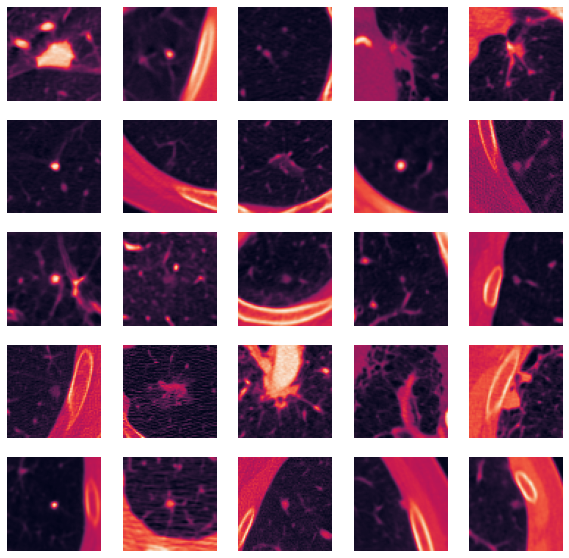

['0377_NI000_slice004.npy', '0379_NI002_slice002.npy', '0384_NI001_slice006.npy', '0385_NI001_slice004.npy', '0385_NI001_slice029.npy', '0386_NI003_slice007.npy', '0388_NI000_slice004.npy', '0388_NI004_slice012.npy', '0390_NI006_slice001.npy', '0394_NI002_slice000.npy', '0395_NI001_slice001.npy', '0397_NI001_slice003.npy', '0398_NI003_slice000.npy', '0398_NI009_slice003.npy', '0400_NI000_slice000.npy', '0402_NI003_slice002.npy', '0402_NI009_slice012.npy', '0404_NI000_slice002.npy', '0404_NI002_slice002.npy', '0404_NI004_slice008.npy', '0405_NI002_slice003.npy', '0406_NI002_slice007.npy', '0408_NI002_slice001.npy', '0409_NI002_slice004.npy', '0411_NI001_slice007.npy']


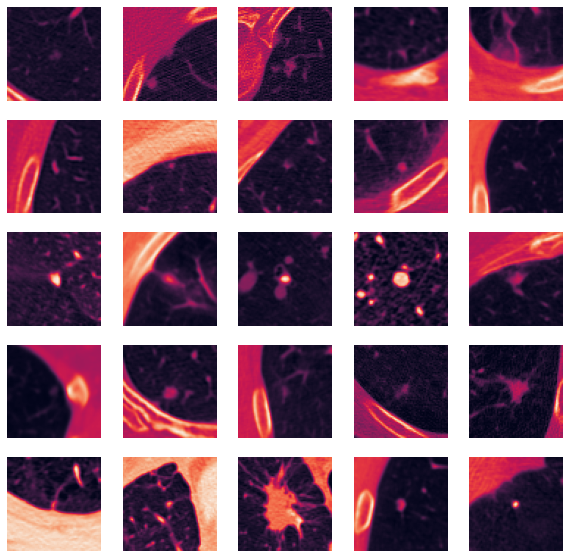

['0413_NI000_slice002.npy', '0415_NI004_slice000.npy', '0415_NI007_slice007.npy', '0416_NI001_slice000.npy', '0421_NI000_slice010.npy', '0424_NI002_slice001.npy', '0427_NI001_slice000.npy', '0429_NI000_slice006.npy', '0430_NI001_slice004.npy', '0433_NI003_slice000.npy', '0434_NI002_slice004.npy', '0436_NI000_slice011.npy', '0437_NI002_slice004.npy', '0438_NI000_slice005.npy', '0440_NI000_slice015.npy', '0442_NI002_slice001.npy', '0445_NI001_slice003.npy', '0448_NI000_slice000.npy', '0450_NI000_slice004.npy', '0450_NI007_slice002.npy', '0452_NI001_slice003.npy', '0454_NI002_slice001.npy', '0454_NI006_slice012.npy', '0456_NI001_slice005.npy', '0459_NI000_slice002.npy']


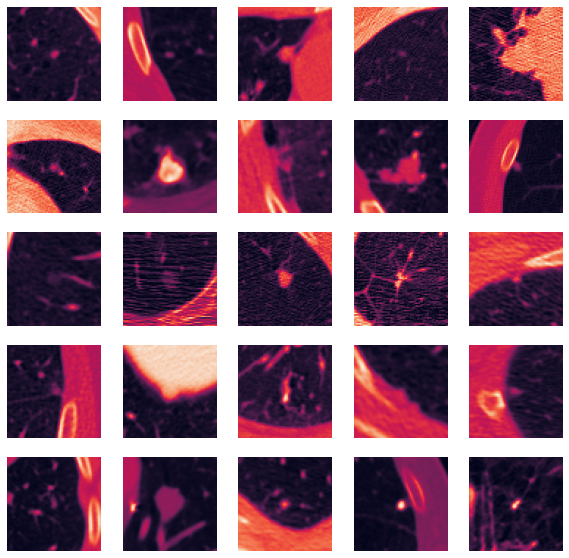

['0460_NI002_slice003.npy', '0462_NI000_slice004.npy', '0462_NI002_slice004.npy', '0464_NI001_slice000.npy', '0466_NI001_slice004.npy', '0466_NI003_slice003.npy', '0469_NI000_slice009.npy', '0469_NI003_slice001.npy', '0470_NI001_slice002.npy', '0473_NI000_slice001.npy', '0474_NI003_slice000.npy', '0476_NI000_slice007.npy', '0476_NI004_slice003.npy', '0477_NI004_slice004.npy', '0479_NI003_slice003.npy', '0481_NI004_slice000.npy', '0484_NI001_slice000.npy', '0486_NI000_slice004.npy', '0487_NI006_slice000.npy', '0488_NI001_slice001.npy', '0489_NI004_slice000.npy', '0490_NI000_slice013.npy', '0490_NI001_slice008.npy', '0491_NI003_slice006.npy', '0491_NI007_slice005.npy']


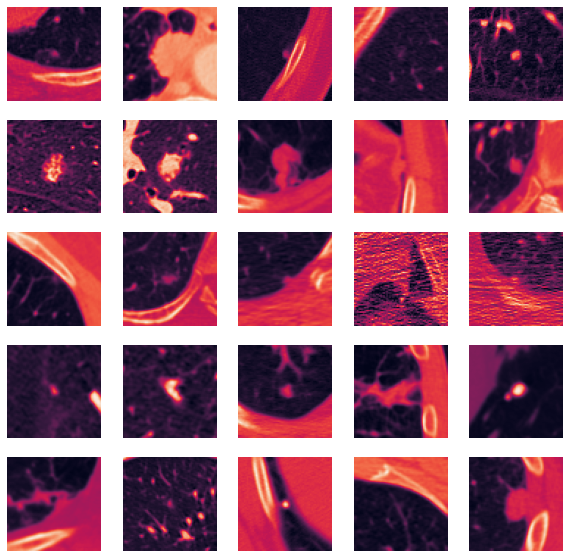

['0492_NI000_slice003.npy', '0493_NI001_slice008.npy', '0496_NI000_slice001.npy', '0498_NI001_slice001.npy', '0501_NI001_slice003.npy', '0507_NI000_slice003.npy', '0507_NI002_slice007.npy', '0508_NI000_slice013.npy', '0510_NI001_slice001.npy', '0510_NI004_slice003.npy', '0510_NI008_slice000.npy', '0515_NI000_slice014.npy', '0520_NI001_slice001.npy', '0523_NI000_slice001.npy', '0523_NI003_slice004.npy', '0524_NI004_slice001.npy', '0525_NI002_slice010.npy', '0526_NI004_slice001.npy', '0529_NI000_slice014.npy', '0530_NI000_slice003.npy', '0534_NI000_slice002.npy', '0535_NI001_slice004.npy', '0541_NI000_slice001.npy', '0542_NI003_slice000.npy', '0543_NI001_slice014.npy']


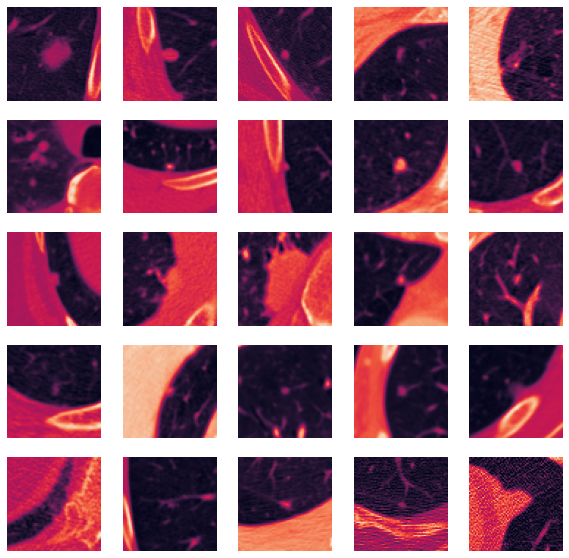

['0546_NI000_slice002.npy', '0547_NI001_slice003.npy', '0549_NI004_slice003.npy', '0553_NI000_slice006.npy', '0553_NI001_slice020.npy', '0556_NI002_slice000.npy', '0559_NI000_slice002.npy', '0563_NI000_slice001.npy', '0566_NI000_slice001.npy', '0569_NI000_slice001.npy', '0572_NI000_slice004.npy', '0576_NI000_slice004.npy', '0576_NI000_slice031.npy', '0577_NI001_slice001.npy', '0580_NI000_slice000.npy', '0582_NI003_slice000.npy', '0583_NI000_slice002.npy', '0583_NI007_slice002.npy', '0583_NI013_slice001.npy', '0583_NI019_slice001.npy', '0584_NI000_slice000.npy', '0587_NI002_slice000.npy', '0587_NI005_slice000.npy', '0591_NI000_slice001.npy', '0594_NI002_slice007.npy']


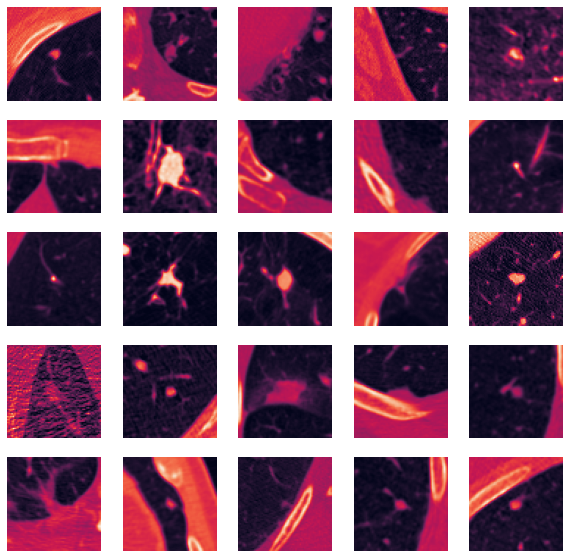

['0596_NI000_slice002.npy', '0601_NI000_slice001.npy', '0601_NI002_slice009.npy', '0602_NI000_slice002.npy', '0604_NI002_slice004.npy', '0604_NI005_slice015.npy', '0606_NI000_slice005.npy', '0606_NI001_slice000.npy', '0606_NI002_slice003.npy', '0608_NI002_slice001.npy', '0609_NI001_slice004.npy', '0614_NI000_slice008.npy', '0614_NI002_slice005.npy', '0617_NI001_slice002.npy', '0618_NI000_slice002.npy', '0619_NI001_slice020.npy', '0621_NI000_slice005.npy', '0624_NI003_slice007.npy', '0624_NI005_slice007.npy', '0625_NI000_slice007.npy', '0629_NI000_slice001.npy', '0633_NI000_slice008.npy', '0636_NI002_slice000.npy', '0637_NI000_slice007.npy', '0637_NI005_slice003.npy']


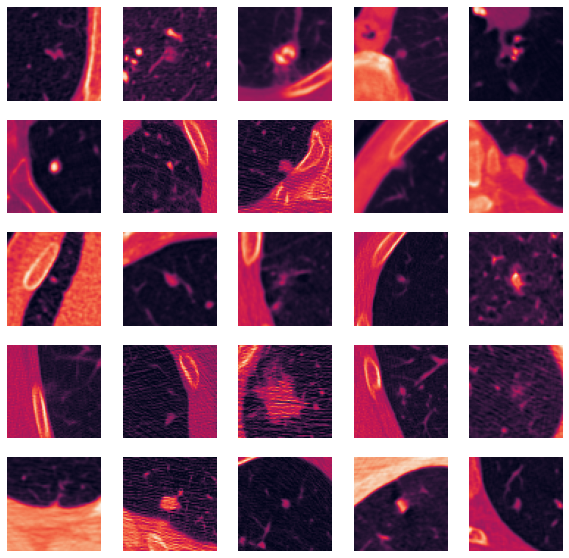

['0637_NI009_slice003.npy', '0639_NI001_slice002.npy', '0641_NI003_slice004.npy', '0642_NI004_slice000.npy', '0648_NI000_slice004.npy', '0648_NI002_slice003.npy', '0649_NI003_slice000.npy', '0650_NI000_slice003.npy', '0651_NI001_slice003.npy', '0651_NI002_slice024.npy', '0655_NI000_slice001.npy', '0655_NI004_slice004.npy', '0655_NI005_slice021.npy', '0656_NI001_slice004.npy', '0659_NI001_slice002.npy', '0660_NI002_slice001.npy', '0661_NI000_slice002.npy', '0661_NI004_slice021.npy', '0662_NI004_slice003.npy', '0663_NI002_slice009.npy', '0666_NI004_slice002.npy', '0671_NI002_slice002.npy', '0671_NI006_slice004.npy', '0673_NI001_slice005.npy', '0674_NI002_slice000.npy']


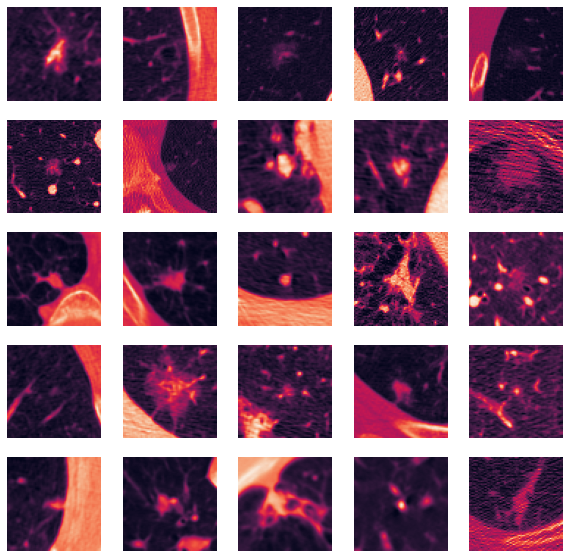

['0678_NI000_slice002.npy', '0681_NI000_slice016.npy', '0682_NI002_slice003.npy', '0686_NI003_slice002.npy', '0686_NI009_slice006.npy', '0686_NI015_slice003.npy', '0687_NI001_slice002.npy', '0688_NI001_slice009.npy', '0688_NI002_slice021.npy', '0697_NI000_slice007.npy', '0698_NI000_slice012.npy', '0698_NI001_slice013.npy', '0700_NI000_slice003.npy', '0701_NI003_slice013.npy', '0702_NI000_slice008.npy', '0702_NI002_slice002.npy', '0702_NI004_slice015.npy', '0702_NI005_slice002.npy', '0703_NI001_slice006.npy', '0704_NI001_slice002.npy', '0705_NI001_slice001.npy', '0707_NI004_slice001.npy', '0709_NI001_slice009.npy', '0713_NI001_slice001.npy', '0714_NI000_slice007.npy']


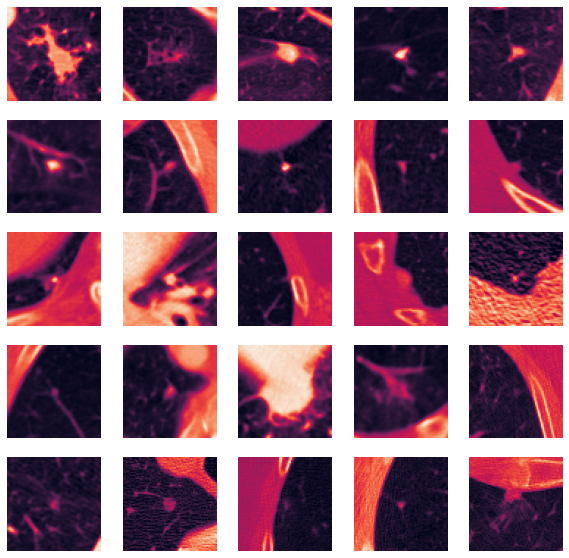

['0715_NI000_slice020.npy', '0715_NI000_slice045.npy', '0720_NI000_slice006.npy', '0722_NI000_slice006.npy', '0722_NI002_slice005.npy', '0724_NI003_slice002.npy', '0728_NI000_slice003.npy', '0733_NI001_slice003.npy', '0733_NI007_slice002.npy', '0735_NI001_slice002.npy', '0741_NI000_slice002.npy', '0741_NI005_slice008.npy', '0742_NI007_slice001.npy', '0742_NI013_slice004.npy', '0744_NI001_slice002.npy', '0748_NI006_slice001.npy', '0749_NI005_slice002.npy', '0751_NI000_slice002.npy', '0751_NI006_slice000.npy', '0754_NI001_slice000.npy', '0757_NI000_slice000.npy', '0759_NI004_slice002.npy', '0762_NI001_slice002.npy', '0762_NI007_slice002.npy', '0765_NI000_slice008.npy']


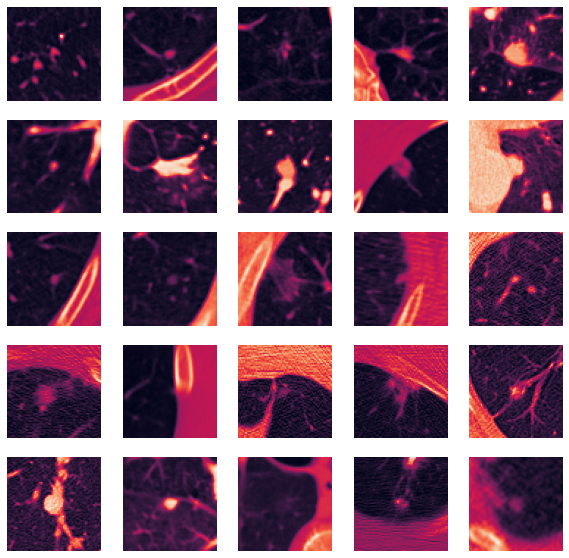

['0768_NI000_slice006.npy', '0770_NI002_slice001.npy', '0770_NI006_slice000.npy', '0770_NI010_slice006.npy', '0772_NI000_slice001.npy', '0773_NI002_slice001.npy', '0775_NI001_slice004.npy', '0775_NI002_slice003.npy', '0775_NI006_slice004.npy', '0776_NI000_slice003.npy', '0777_NI001_slice001.npy', '0779_NI000_slice001.npy', '0780_NI001_slice017.npy', '0781_NI000_slice003.npy', '0785_NI003_slice001.npy', '0785_NI004_slice016.npy', '0787_NI002_slice002.npy', '0790_NI001_slice000.npy', '0790_NI001_slice025.npy', '0791_NI000_slice016.npy', '0793_NI001_slice005.npy', '0795_NI000_slice001.npy', '0798_NI001_slice002.npy', '0800_NI002_slice001.npy', '0801_NI003_slice000.npy']


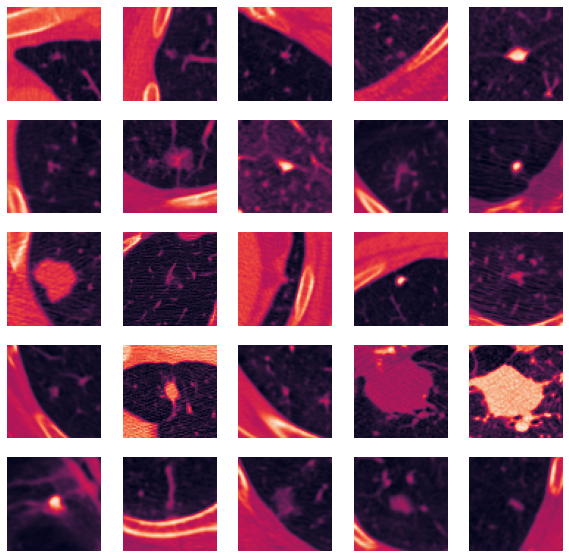

['0806_NI001_slice002.npy', '0806_NI006_slice002.npy', '0806_NI009_slice002.npy', '0807_NI000_slice002.npy', '0807_NI003_slice012.npy', '0810_NI001_slice003.npy', '0811_NI000_slice003.npy', '0813_NI001_slice001.npy', '0815_NI000_slice013.npy', '0819_NI000_slice004.npy', '0819_NI002_slice012.npy', '0820_NI003_slice002.npy', '0822_NI000_slice000.npy', '0822_NI006_slice001.npy', '0826_NI000_slice009.npy', '0827_NI002_slice003.npy', '0829_NI000_slice013.npy', '0830_NI000_slice000.npy', '0834_NI000_slice005.npy', '0834_NI000_slice030.npy', '0835_NI001_slice004.npy', '0837_NI001_slice002.npy', '0837_NI002_slice020.npy', '0838_NI000_slice019.npy', '0838_NI004_slice006.npy']


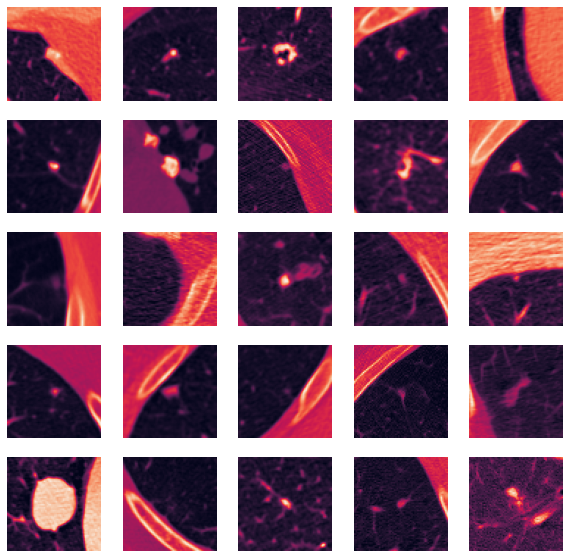

['0843_NI003_slice000.npy', '0843_NI005_slice009.npy', '0844_NI001_slice009.npy', '0845_NI000_slice011.npy', '0849_NI000_slice011.npy', '0849_NI004_slice006.npy', '0849_NI006_slice007.npy', '0850_NI001_slice001.npy', '0852_NI001_slice002.npy', '0854_NI002_slice006.npy', '0855_NI003_slice001.npy', '0856_NI000_slice004.npy', '0858_NI002_slice002.npy', '0858_NI004_slice004.npy', '0858_NI009_slice001.npy', '0859_NI000_slice002.npy', '0863_NI000_slice003.npy', '0864_NI002_slice000.npy', '0866_NI003_slice001.npy', '0867_NI001_slice004.npy', '0869_NI001_slice010.npy', '0869_NI002_slice016.npy', '0870_NI004_slice003.npy', '0871_NI003_slice001.npy', '0873_NI000_slice001.npy']


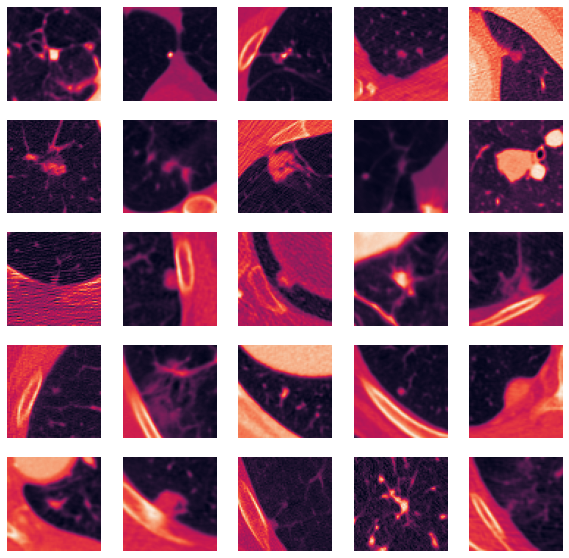

['0874_NI000_slice023.npy', '0874_NI003_slice004.npy', '0879_NI000_slice000.npy', '0879_NI006_slice001.npy', '0883_NI000_slice000.npy', '0884_NI001_slice003.npy', '0888_NI000_slice001.npy', '0890_NI002_slice013.npy', '0892_NI003_slice000.npy', '0893_NI001_slice013.npy', '0894_NI004_slice003.npy', '0896_NI000_slice005.npy', '0902_NI000_slice007.npy', '0904_NI000_slice003.npy', '0906_NI000_slice005.npy', '0907_NI001_slice000.npy', '0910_NI000_slice003.npy', '0912_NI001_slice003.npy', '0912_NI005_slice003.npy', '0912_NI006_slice022.npy', '0913_NI000_slice005.npy', '0913_NI002_slice013.npy', '0916_NI006_slice000.npy', '0919_NI000_slice010.npy', '0920_NI000_slice019.npy']


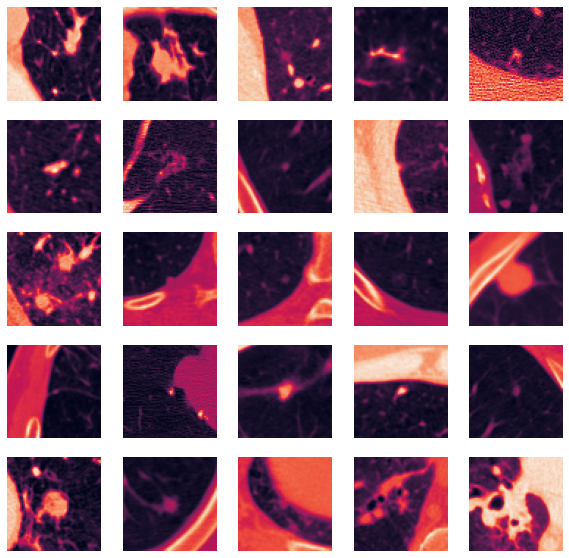

['0921_NI001_slice014.npy', '0921_NI003_slice016.npy', '0922_NI000_slice000.npy', '0924_NI000_slice007.npy', '0928_NI000_slice000.npy', '0933_NI005_slice001.npy', '0936_NI000_slice004.npy', '0939_NI001_slice002.npy', '0939_NI002_slice022.npy', '0940_NI001_slice010.npy', '0942_NI000_slice017.npy', '0943_NI000_slice000.npy', '0947_NI001_slice001.npy', '0947_NI004_slice007.npy', '0949_NI000_slice002.npy', '0951_NI002_slice003.npy', '0956_NI001_slice003.npy', '0961_NI004_slice000.npy', '0963_NI000_slice003.npy', '0966_NI002_slice001.npy', '0968_NI001_slice019.npy', '0972_NI002_slice001.npy', '0976_NI000_slice001.npy', '0978_NI000_slice000.npy', '0978_NI000_slice025.npy']


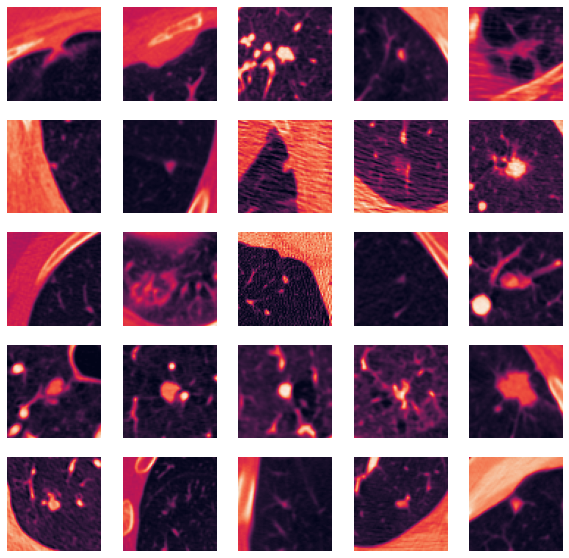

['0978_NI003_slice000.npy', '0978_NI003_slice025.npy', '0978_NI004_slice010.npy', '0982_NI000_slice005.npy', '0982_NI002_slice009.npy', '0985_NI001_slice003.npy', '0987_NI002_slice002.npy', '0994_NI000_slice002.npy', '0994_NI003_slice004.npy', '0994_NI004_slice017.npy', '0996_NI000_slice000.npy', '0998_NI000_slice001.npy', '0999_NI000_slice001.npy', '1001_NI001_slice001.npy', '1002_NI001_slice003.npy', '1002_NI002_slice002.npy', '1002_NI003_slice005.npy', '1003_NI003_slice002.npy', '1003_NI007_slice003.npy', '1004_NI002_slice013.npy', '1005_NI000_slice001.npy', '1006_NI000_slice000.npy', '1008_NI001_slice002.npy', '1010_NI000_slice001.npy', '1012_NI000_slice001.npy']


IndexError: list index out of range

In [46]:
for i in range(int(0.1*len(all_files_list)/25)):
    files_list = []
    for j in range(25):
        files_list.append(all_files_list[25*int(0.1*len(all_files_list)/25 + i*25+j)])
    view_img(files_list)
